# Assignment 2: Evaluating and Extending an RNN based Part-of-Speech Tagger

*version 2024.1, bugs might be patched after publication, you will be notified if this happens*

When solving a new problem (or an old problem on a new data set), there are often some "shoulders of giants" to stand on. Your first step is often to look for recent and/or well cited papers, and try to download someone's code for solving a similar problem to the one you are faced with. The challenge is as much about understanding and adapting already existing code as it is about theoretical knowledge and scientific creativity.

For this assignment, you start with a working pipeline for PoS tagging using LSTMs and mini-batch training. Your task is to evaluate the model on a number of sources in different languages, and extend it with new functionality. First, the neural model represents your tokens as non-pretrained embedding vectors. Then the sequences of embedding vectors are passed through an LSTM layer. Finally, the outputs from the recurrent layer are transformed to probabilities over PoS tags by passing them through a fully connected layer and a softmax. You will have to refactor (i.e. rearrange the code) and extend the model by adding some commonly used properties, e.g. bi-directionality (see the list of suggestions below).

The familiar Brown corpus is used for the reference implementation. This corpus should not be used in your submission.

## Submission

Please submit your code as a notebook through studium. Your submission must satisfy the following requirements:

1. A working implementation of your pipeline, reproducing your principal results when run (including downloading any data). Please ensure that outputs are stored in the notebook (preferably by rerunning your notebook as the last thing you do before submitting).
2. Comment the code properly, especially for longer or opaque functionality. Please try to write self documenting code (e.g. choosing descriptive variables names, refactor to isolate functionality and minimize code duplication). This will also help you debug your code.
4. Comments on what you thought was hard in the assignment, what you think was educational, what took most time, and which parts might be unnecessarily tricky.
5. As the submission is anonymous, **all personal information must be removed**.
6. Apart from sections and titles, please remove all unnecessary text and code from the notebook you hand in (e.g., this instuction). Keep only that which strengthens the case that you fulfil the goals for the grade that you want.


## Requirements for grade G

To achieve a pass (G) on this assignment, you must solve the following tasks without serious errors:

1. Extend the given model in at least three of the ways listed in the *extensions* section. State clearly which ones you have implemented.
2. Include a short (250-500 words) qualitative analysis in your submission. Discuss the performance difference between languages/genres and design choices. You can spread this in the notebook or put them in one place.
3. Refactor the given model as a class (including relevant preprocessing, forward/backward pass etc). Your model class should follow the sklearn API where possible.
4. Not all languages require the same model complexity for PoS tagging. Some might need a higher dimensionality for the embedding or layers for the model to perform well. Briefly explore the relation between model complexity and accuracy. (Note that the goal is to examine model properties, not to get state-of-the-art accuracy)
5. In your quantitative evaluation, use some genre of text in three languages from the [universal dependencies](https://universaldependencies.org/) project (UD). These will be in the familiar `.conllu` format. Parse the files to get the words (not lemmas).
6. Network accuracy for one model doesn't say much about how well a model performs. For some problems, 90% accuracy is easy to achieve, while for other problems 40% is state of the art. Establish a baseline accuracy (in code) and compare your results to it.
7. The training and testing data must be kept separate. This means that you could be forced to process unknown tokens from the test data. You should find some way of handling these out-of-vocabulary words (OOV).


### Additional requirements for grade VG

For a pass with distinction grade (VG), you should extend your analysis to include all the items under *extensions*. In addition, prepare (and hand in) a short presentation in pdf format (2-4 slides, 200-500 word synopsis) presenting some of your results, design choices, and data sources. You can make your life easier by choosing a language that you speak, test different pipeline alternatives and genres, and, finally, show your results and interpret them.


### Extensions

1. There are other types of RNNs layers commonly used in NLP. Add the option to use a GRU layer instead of an LSTM layer, and include this in your performance comparison.
2. The given implementation only allows for dependencies from left to right. Add the option to use a bi-directional RNN layer.
3. Use pyTorch's `Dataset` and `DataLoader` classes for loading the data. [This tutorial](https://pytorch.org/tutorials/beginner/data_loading_tutorial.html) is a good starting point. Proper data loaders makes it easier to loop over data sets.
4. Try some type of data augmentation in your training data (e.g. masking random tokens). This should theoretically increase the generalizability of your model. How much augmentation is too much?
5. Implement some level of regularization in your model. This can be implemented in several ways, e.g. dropout or weight decay. Briefly argue for the choices you made and show how network preformance might change with the rate of regularization.
6. Add more sources. Either from different genres and/or adding more languages. A suggestion is to try how languages with very different levels of morphological richness (e.g. English vs Finnish) requires more or less training data, or how well a model trained on academic english does on news text. The total number of sources should be above 10.
7. Compare performace using UD's universal vs language specific tag sets.

*Note that fully evaluating all combinations of the extensions is not required. It is enough to do some structured testing of extensions and then, for example, go on to compare the tag sets on the best model configuration. This is an exercise in extending and evaluating a model, not in finding the patience to wait for your computer to finish grid searching over alternatives.*


## General advice

Work from the given code and change one piece at a time, ensuring functionality throughout your work. You should test your code every couple of lines to make sure your assumptions on functionality and variable content are correct. A good rule of thumb is that a coder will introduce a bug every five lines (even as a professional).

To make sure your code does what it's supposed to do, use ```assert``` statements to check your assumptions. Keep the given asserts if you need them. Professional coders sometimes start with writing tests for some functionality instead of starting with the functionality itself. This is called *test-driven development*.

Using a platform with a GPU will be very helpful.

Finally, remember the great motto **RTFM**. It will save you in the future.


## Plagiarism

In code assignments, plagiarism is a tricky concept. A clean cut way would be to demand that you write all the code yourself, from memory, with only the assigned literature as help. This is not how code is developed professionally though. It is common to copy and share. However, since this is a learning exercise, you must implement everything on your own, but please look at the course repo, Stack Overflow etc. Moreover, discuss with course mates and TAs to find inspiration and solutions. Code that is *obviously* copied (with minor modifications) will be considered as plagiarized. As a part of the examination, you might be asked to explain any particular part of the functionality in your implementation.

In [ ]:
# Our standard imports for maths and basic methodology
import numpy as np
from sklearn.model_selection import train_test_split

# For user feedback
from tqdm import tqdm
import matplotlib.pyplot as plt

# Imports for pytorch
import torch
import torch.nn as nn

Let's see if we have a GPU.

In [ ]:
if torch.cuda.is_available():
  for i in range(torch.cuda.device_count()):
    print(torch.cuda.get_device_name(i))
else:
  print("No GPU available")

No GPU available


## Load tagging data

The following downloads the [Brown corpus](https://en.wikipedia.org/wiki/Brown_Corpus). This data is only here to demonstrate the network below.

In [ ]:
import requests
from collections import Counter
import matplotlib.pyplot as plt
import numpy as np


def parse_conllu_from_url(url):
    response = requests.get(url)
    response.raise_for_status()

    text = response.text
    lines = text.split('\n')

    words = []
    for line in lines:
        line = line.strip()
        if not line or line.startswith('#'):
            continue
        columns = line.split('\t')
        if len(columns) > 1:
            word = columns[1]
            words.append(word)
    return words


english_url = "https://raw.githubusercontent.com/UniversalDependencies/UD_English-EWT/master/en_ewt-ud-train.conllu"
spanish_url = "https://raw.githubusercontent.com/UniversalDependencies/UD_Spanish-GSD/master/es_gsd-ud-train.conllu"
chinese_url = "https://raw.githubusercontent.com/UniversalDependencies/UD_Chinese-GSDSimp/master/zh_gsdsimp-ud-train.conllu"
german_url = "https://raw.githubusercontent.com/UniversalDependencies/UD_German-GSD/master/de_gsd-ud-train.conllu"

english_words = parse_conllu_from_url(english_url)
spanish_words = parse_conllu_from_url(spanish_url)
chinese_words = parse_conllu_from_url(chinese_url)
german_words = parse_conllu_from_url(german_url)

print("English sample:", english_words[:20])
print("Spanish sample:", spanish_words[:20])
print("Chinese sample:", chinese_words[:20])
print("German sample:", german_words[:20])

English sample: ['Al', '-', 'Zaman', ':', 'American', 'forces', 'killed', 'Shaikh', 'Abdullah', 'al', '-', 'Ani', ',', 'the', 'preacher', 'at', 'the', 'mosque', 'in', 'the']
Spanish sample: ['Además', 'se', 'le', 'pediría', 'a', 'las', 'empresas', 'interesadas', 'en', 'prestar', 'el', 'servicio', 'que', 'se', 'hagan', 'cargo', 'de', 'la', 'señalización', 'y']
Chinese sample: ['看似', '简单', '，', '只', '是', '二', '选', '一', '做', '决择', '，', '但', '其实', '他们', '代表', '的', '是', '你', '周遭', '的']
German sample: ['Sehr', 'gute', 'Beratung', ',', 'schnelle', 'Behebung', 'der', 'Probleme', ',', 'so', 'stelle', 'ich', 'mir', 'Kundenservice', 'vor', '.', 'Die', 'Kosten', 'sind', 'definitiv']


In [ ]:
import nltk
nltk.download('brown')
from nltk.corpus import brown
nltk.download('universal_tagset')

sentences = brown.tagged_sents(tagset='universal')
sentences = [sentence for sentence in sentences if len(sentence) > 2]

print("Loaded %i sentences" % len(sentences))
print(sentences[0])

[nltk_data] Downloading package brown to /root/nltk_data...
[nltk_data]   Package brown is already up-to-date!
[nltk_data] Downloading package universal_tagset to /root/nltk_data...
[nltk_data]   Package universal_tagset is already up-to-date!


Loaded 56283 sentences
[('The', 'DET'), ('Fulton', 'NOUN'), ('County', 'NOUN'), ('Grand', 'ADJ'), ('Jury', 'NOUN'), ('said', 'VERB'), ('Friday', 'NOUN'), ('an', 'DET'), ('investigation', 'NOUN'), ('of', 'ADP'), ("Atlanta's", 'NOUN'), ('recent', 'ADJ'), ('primary', 'NOUN'), ('election', 'NOUN'), ('produced', 'VERB'), ('``', '.'), ('no', 'DET'), ('evidence', 'NOUN'), ("''", '.'), ('that', 'ADP'), ('any', 'DET'), ('irregularities', 'NOUN'), ('took', 'VERB'), ('place', 'NOUN'), ('.', '.')]


Preprocessing for the brow corpus. This splits the data into our standard X and y format.

In [ ]:
X = [[token for token, tag in sentence] for sentence in sentences]
y = [[tag for token, tag in sentence] for sentence in sentences]

assert len(X) == len(y)

print(X[0])
print(y[0])

['The', 'Fulton', 'County', 'Grand', 'Jury', 'said', 'Friday', 'an', 'investigation', 'of', "Atlanta's", 'recent', 'primary', 'election', 'produced', '``', 'no', 'evidence', "''", 'that', 'any', 'irregularities', 'took', 'place', '.']
['DET', 'NOUN', 'NOUN', 'ADJ', 'NOUN', 'VERB', 'NOUN', 'DET', 'NOUN', 'ADP', 'NOUN', 'ADJ', 'NOUN', 'NOUN', 'VERB', '.', 'DET', 'NOUN', '.', 'ADP', 'DET', 'NOUN', 'VERB', 'NOUN', '.']


In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.1, random_state=0)

assert len(X_train) == len(y_train)
assert len(X_test) == len(y_test)
assert len(X_train)+len(X_test) == len(X)

print("The training set includes %i sentences" % len(X_train))
print("The test set includes %i sentences" % len(X_test))

The training set includes 50654 sentences
The test set includes 5629 sentences


Most sentences are short, but some are very long.

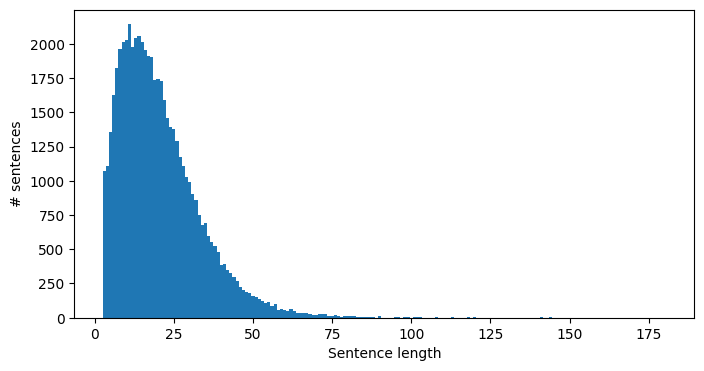

In [ ]:
l = np.asarray([len(x) for x in X], dtype=int)
plt.figure(figsize=(8, 4))
x = np.unique(l)
plt.bar(x, [np.sum(l==e) for e in x], width=1)
plt.xlabel("Sentence length")
plt.ylabel("# sentences")
plt.show()

## Data encoding and padding

In [ ]:
tokens = {token for sentence in X_train for token in sentence}
idx2token = list(tokens)
idx2token.insert(0, '<UNK>')
idx2token.append('<PAD>')
token2idx = {token:idx for idx, token in enumerate(idx2token)}

tags = {tag for tags in y_train for tag in tags}
idx2tag = list(tags)
idx2tag.append('<PAD>')
tag2idx = {tag:idx for idx, tag in enumerate(idx2tag)}

print(idx2token[:15])
print(idx2tag)

['<UNK>', 'caterpillars', 'edema', 'controller', 'exerting', 'Bedtime', 'bio-medicine', 'hazardous', 'Sweating', 'Cody', '0.001', 'inserted', 'wages', 'insinuating', 'irrevocable']
['ADJ', 'PRT', 'CONJ', 'VERB', 'X', 'DET', 'NOUN', 'ADP', '.', 'NUM', 'PRON', 'ADV', '<PAD>']


In [ ]:
def pad_and_encode(sentences, labels):
  assert len(sentences)==len(labels)
  assert np.all([len(sentence)==len(tags) for sentence, tags in zip(sentences, labels)])
  max_sentence_length = np.max([len(sentence) for sentence in sentences])
  padded_sentences = torch.zeros(len(sentences), max_sentence_length,
                                 dtype=torch.long)
  padded_sentences[:] = token2idx['<PAD>']
  padded_labels = torch.zeros(len(sentences), max_sentence_length,
                              dtype=torch.long)
  padded_labels[:] = tag2idx['<PAD>']
  for i, (sentence, tags) in enumerate(zip(sentences, labels)):
    for j, token in enumerate(sentence):
      if token in token2idx.keys():
        padded_sentences[i, j] = token2idx[token]
      else:
        padded_sentences[i, j] = token2idx['<UNK>']
    for j, tag in enumerate(tags):
      padded_labels[i, j] = tag2idx[tag]
  return padded_sentences, padded_labels

a, b = pad_and_encode(X_train[:5], y_train[:5])
print(a)
print(b)

tensor([[31473, 29317, 33644, 15284,  6527, 34033, 46527, 24950, 49728, 48727,
         46527, 24950, 53193, 46527, 33409, 13163, 38199, 53337, 53337, 53337,
         53337, 53337, 53337, 53337, 53337, 53337, 53337, 53337, 53337],
        [ 1810, 22084, 39382, 44953, 43540, 40201, 43077, 30297,   285,   568,
         51536, 43407, 39382,  1461, 42467, 36344, 43077, 33793,   285,  1179,
         23378, 38675, 24451,  7915,  1965, 46527, 36344, 43589, 38199],
        [ 5532, 35567, 11165, 40686,  1461,  1251, 31469, 39382,  7834, 28469,
          7834,  5532, 37144, 28511, 38199, 53337, 53337, 53337, 53337, 53337,
         53337, 53337, 53337, 53337, 53337, 53337, 53337, 53337, 53337],
        [25008, 23475,  1906, 29933,  1461, 52879, 23475,  1906, 18877, 38199,
         53337, 53337, 53337, 53337, 53337, 53337, 53337, 53337, 53337, 53337,
         53337, 53337, 53337, 53337, 53337, 53337, 53337, 53337, 53337],
        [12856, 21186, 24950, 22411, 39382, 21186, 24950, 43462, 39382, 3015

In [ ]:
def batch_iterator(sentences, labels, batch_size=64):
  assert len(sentences) == len(labels)
  for i in range(0, len(sentences), batch_size):
    X, y = pad_and_encode(sentences[i:min(i+batch_size, len(sentences))],
                          labels[i:min(i+batch_size, len(sentences))])
    if torch.cuda.is_available():
      yield (X.cuda(), y.cuda())
    else:
      yield (X, y)

next(batch_iterator(X_train, y_train, batch_size=5))

(tensor([[31473, 29317, 33644, 15284,  6527, 34033, 46527, 24950, 49728, 48727,
          46527, 24950, 53193, 46527, 33409, 13163, 38199, 53337, 53337, 53337,
          53337, 53337, 53337, 53337, 53337, 53337, 53337, 53337, 53337],
         [ 1810, 22084, 39382, 44953, 43540, 40201, 43077, 30297,   285,   568,
          51536, 43407, 39382,  1461, 42467, 36344, 43077, 33793,   285,  1179,
          23378, 38675, 24451,  7915,  1965, 46527, 36344, 43589, 38199],
         [ 5532, 35567, 11165, 40686,  1461,  1251, 31469, 39382,  7834, 28469,
           7834,  5532, 37144, 28511, 38199, 53337, 53337, 53337, 53337, 53337,
          53337, 53337, 53337, 53337, 53337, 53337, 53337, 53337, 53337],
         [25008, 23475,  1906, 29933,  1461, 52879, 23475,  1906, 18877, 38199,
          53337, 53337, 53337, 53337, 53337, 53337, 53337, 53337, 53337, 53337,
          53337, 53337, 53337, 53337, 53337, 53337, 53337, 53337, 53337],
         [12856, 21186, 24950, 22411, 39382, 21186, 24950, 43462

## Model

In [ ]:
class LSTMTagger(nn.Module):
  def __init__(self, word_embedding_dim, lstm_hidden_dim, vocabulary_size, tagset_size):
    super(LSTMTagger, self).__init__()
    self.lstm_hidden_dim_ = lstm_hidden_dim
    self.vocabulary_size_ = vocabulary_size
    self.tagset_size_ = tagset_size

    self._word_embedding = nn.Embedding(num_embeddings=vocabulary_size,
                                         embedding_dim=word_embedding_dim,
                                         padding_idx=token2idx['<PAD>'])
    self._lstm = nn.LSTM(input_size=word_embedding_dim,
                         hidden_size=lstm_hidden_dim,
                         batch_first=True)
    self._fc = nn.Linear(lstm_hidden_dim, tagset_size)
    self._softmax = nn.LogSoftmax(dim=1)

    self.training_loss_ = list()
    self.training_accuracy_ = list()

    if torch.cuda.is_available():
      self.cuda()

  def forward(self, padded_sentences):
    """The forward pass through the network"""
    batch_size, max_sentence_length = padded_sentences.size()

    embedded_sentences = self._word_embedding(padded_sentences)

    sentence_lengths = (padded_sentences!=token2idx['<PAD>']).sum(dim=1)
    sentence_lengths = sentence_lengths.long().cpu()
    X = nn.utils.rnn.pack_padded_sequence(embedded_sentences, sentence_lengths,
                                          batch_first=True, enforce_sorted=False)
    lstm_out, _ = self._lstm(X)
    X, _ = nn.utils.rnn.pad_packed_sequence(lstm_out, batch_first=True)

    X = X.contiguous().view(-1, X.shape[2])
    tag_space = self._fc(X)
    tag_scores = self._softmax(tag_space)
    return tag_scores.view(batch_size, max_sentence_length, self.tagset_size_)


model = LSTMTagger(word_embedding_dim=32,
                   lstm_hidden_dim=64,
                   vocabulary_size=len(token2idx),
                   tagset_size=len(tag2idx)-1)
print(model)

LSTMTagger(
  (_word_embedding): Embedding(53338, 32, padding_idx=53337)
  (_lstm): LSTM(32, 64, batch_first=True)
  (_fc): Linear(in_features=64, out_features=12, bias=True)
  (_softmax): LogSoftmax(dim=1)
)


## Network training

In [ ]:
loss_function = nn.NLLLoss(ignore_index=tag2idx['<PAD>'])

optimizer = torch.optim.Adam(model.parameters(), lr=0.01)

batch_size = 256
for epoch in range(5):
  with tqdm(batch_iterator(X_train, y_train, batch_size=batch_size),
            total=len(X_train)//batch_size+1, unit="batch", desc="Epoch %i" % epoch) as batches:
    for inputs, targets in batches:
      model.zero_grad()
      scores = model(inputs)
      loss = loss_function(scores.view(-1, model.tagset_size_),
                           targets.view(-1))
      loss.backward()
      optimizer.step()
      predictions = scores.argmax(dim=2, keepdim=True).squeeze()
      mask = targets!=tag2idx['<PAD>']
      correct = (predictions[mask] == targets[mask]).sum().item()
      accuracy = correct / mask.sum().item()*100
      model.training_accuracy_.append(accuracy)
      model.training_loss_.append(loss.item())
      batches.set_postfix(loss=loss.item(), accuracy=accuracy)

Epoch 4: 100%|██████████| 198/198 [01:21<00:00,  2.44batch/s, accuracy=98, loss=0.0535]


We can plot the stored loss over epochs.

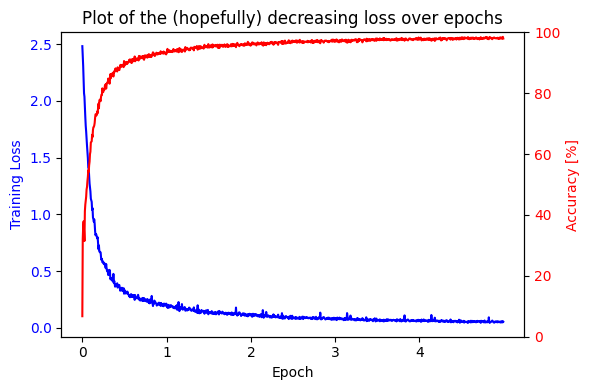

In [ ]:
fig = plt.figure(figsize=(6, 4))
ax = plt.subplot()
ax.set_title("Plot of the (hopefully) decreasing loss over epochs")
ax.plot(model.training_loss_, 'b-')
ax.set_ylabel("Training Loss", color='b')
ax.set_xlabel("Epoch")
# ax.set_yscale('log')
ax.tick_params(axis='y', labelcolor='b')
ax = ax.twinx()
ax.plot(model.training_accuracy_, 'r-')
ax.set_ylabel("Accuracy [%]", color='r')
ax.tick_params(axis='y', labelcolor='r')
a = list(ax.axis())
a[2] = 0
a[3] = 100
ax.axis(a)
t = np.arange(0, len(model.training_accuracy_), len(X_train)//batch_size+1)
ax.set_xticks(ticks=t)
ax.set_xticklabels(labels=np.arange(len(t)))
fig.tight_layout()
plt.show()

## Test data accuracy

This shows that the model sort of works. A per sentence accuracy would be better while being able to also analyse the predictions qualitatively would be best.

In [ ]:
with torch.no_grad():
  n_correct = 0
  n_total = 0
  for inputs, targets in batch_iterator(X_test, y_test, batch_size=batch_size):
    scores = model(inputs)
    predictions = scores.argmax(dim=2, keepdim=True).squeeze()
    mask = targets!=tag2idx['<PAD>']
    n_correct += (predictions[mask] == targets[mask]).sum().item()
    n_total += mask.sum().item()
print("Test accuracy %.1f%%" % (100*n_correct/n_total))

Test accuracy 95.7%


### Assignment2 postagger

In [ ]:
!pip install datasets
!pip install conllu

DatasetDict({
    train: Dataset({
        features: ['idx', 'text', 'tokens', 'lemmas', 'upos', 'xpos', 'feats', 'head', 'deprel', 'deps', 'misc'],
        num_rows: 12543
    })
    validation: Dataset({
        features: ['idx', 'text', 'tokens', 'lemmas', 'upos', 'xpos', 'feats', 'head', 'deprel', 'deps', 'misc'],
        num_rows: 2002
    })
    test: Dataset({
        features: ['idx', 'text', 'tokens', 'lemmas', 'upos', 'xpos', 'feats', 'head', 'deprel', 'deps', 'misc'],
        num_rows: 2077
    })
})
['Al', '-', 'Zaman', ':', 'American', 'forces', 'killed', 'Shaikh', 'Abdullah', 'al', '-', 'Ani', ',', 'the', 'preacher', 'at', 'the', 'mosque', 'in', 'the', 'town', 'of', 'Qaim', ',', 'near', 'the', 'Syrian', 'border', '.']
[10, 1, 10, 1, 6, 0, 16, 10, 10, 10, 1, 10, 1, 8, 0, 2, 8, 0, 2, 8, 0, 2, 10, 1, 2, 8, 6, 0, 1]
Loaded 11401 sentences
(['Al', '-', 'Zaman', ':', 'American', 'forces', 'killed', 'Shaikh', 'Abdullah', 'al', '-', 'Ani', ',', 'the', 'preacher', 'at', 'the', 'mo

Epoch 4: 100%|██████████| 41/41 [00:13<00:00,  3.12batch/s, accuracy=97.4, loss=0.0957]


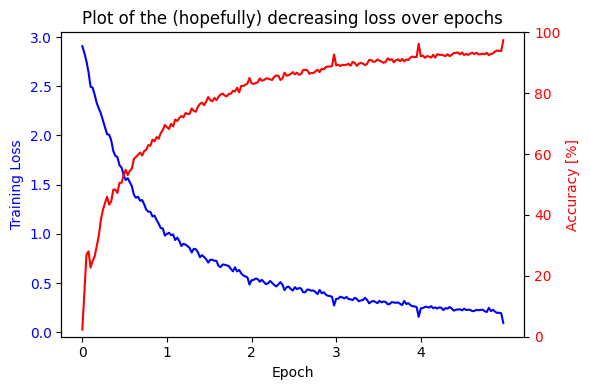

Test accuracy 88.2%


In [ ]:
import torch
import torch.nn as nn
import torch.optim as optim
import numpy as np
from datasets import load_dataset
from sklearn.model_selection import train_test_split
from tqdm import tqdm
import matplotlib.pyplot as plt

class POSTagger:
    def __init__(self, word_embedding_dim=32, lstm_hidden_dim=64, batch_size=256, learning_rate=0.01, epochs=5):
        self.word_embedding_dim = word_embedding_dim
        self.lstm_hidden_dim = lstm_hidden_dim
        self.batch_size = batch_size
        self.learning_rate = learning_rate
        self.epochs = epochs

        self.X = []
        self.y = []
        self.X_train = None
        self.X_test = None
        self.y_train = None
        self.y_test = None

        self.token2idx = None
        self.idx2token = None
        self.tag2idx = None
        self.idx2tag = None

        self.model = None

    def load_data(self):
        # Load the dataset
        dataset = load_dataset("universal_dependencies", "en_ewt")

        print(dataset)

        for sentence in dataset['train']:
            tokens = sentence["tokens"]
            tags = sentence["upos"]
            self.X.append(tokens)
            self.y.append(tags)

        assert len(self.X) == len(self.y)

        print(self.X[0])
        print(self.y[0])


        sentences = [sentence for sentence in zip(self.X, self.y) if len(sentence[0]) > 2]
        self.X = [s[0] for s in sentences]
        self.y = [s[1] for s in sentences]

        print("Loaded %i sentences" % len(sentences))
        print(sentences[0])

        #
        self.X_train, self.X_test, self.y_train, self.y_test = train_test_split(
            self.X, self.y, test_size=0.1, random_state=0
        )

        assert len(self.X_train) == len(self.y_train)
        assert len(self.X_test) == len(self.y_test)
        assert len(self.X_train) + len(self.X_test) == len(self.X)

        print("The training set includes %i sentences" % len(self.X_train))
        print("The test set includes %i sentences" % len(self.X_test))

    def create_vocabulary(self):
        tokens = set()
        upos = set()


        for sentence in self.X_train:
            for token in sentence:
                tokens.add(token)

        for tags in self.y_train:
            for tag in tags:
                upos.add(tag)

        #
        self.idx2token = list(tokens)
        self.idx2token.insert(0, '<UNK>')
        self.idx2token.append('<PAD>')
        self.token2idx = {token: idx for idx, token in enumerate(self.idx2token)}

        self.idx2tag = list(upos)
        self.idx2tag.append('<PAD>')
        self.tag2idx = {tag: idx for idx, tag in enumerate(self.idx2tag)}


        print("Token to Index Mapping:", self.token2idx)
        print("Index to Token Mapping:", self.idx2token)
        print("Tag to Index Mapping:", self.tag2idx)
        print("Index to Tag Mapping:", self.idx2tag)

    def pad_and_encode(self, sentences, labels):
        assert len(sentences) == len(labels)
        assert np.all([len(sentence) == len(tags) for sentence, tags in zip(sentences, labels)])

        max_sentence_length = np.max([len(sentence) for sentence in sentences])
        padded_sentences = torch.zeros(len(sentences), max_sentence_length,
                                     dtype=torch.long)
        padded_sentences[:] = self.token2idx['<PAD>']
        padded_labels = torch.zeros(len(sentences), max_sentence_length,
                                  dtype=torch.long)
        padded_labels[:] = self.tag2idx['<PAD>']

        for i, (sentence, tags) in enumerate(zip(sentences, labels)):
            for j, token in enumerate(sentence):
                if token in self.token2idx.keys():
                    padded_sentences[i, j] = self.token2idx[token]
                else:
                    padded_sentences[i, j] = self.token2idx['<UNK>']
            for j, tag in enumerate(tags):
                padded_labels[i, j] = self.tag2idx[tag]

        return padded_sentences, padded_labels

    def batch_iterator(self, sentences, labels, batch_size=64):
        """Helper function for iterating over batches of the data"""
        assert len(sentences) == len(labels)
        for i in range(0, len(sentences), batch_size):
            X, y = self.pad_and_encode(
                sentences[i:min(i+batch_size, len(sentences))],
                labels[i:min(i+batch_size, len(sentences))]
            )
            if torch.cuda.is_available():
                yield (X.cuda(), y.cuda())
            else:
                yield (X, y)

    def initialize_model(self):
        self.model = LSTMTagger(
            word_embedding_dim=self.word_embedding_dim,
            lstm_hidden_dim=self.lstm_hidden_dim,
            vocabulary_size=len(self.token2idx),
            tagset_size=len(self.tag2idx)-1,
            token2idx=self.token2idx,
            tag2idx=self.tag2idx
        )
        print(self.model)

    def train(self):
        loss_function = nn.NLLLoss(ignore_index=self.tag2idx['<PAD>'])
        optimizer = torch.optim.Adam(self.model.parameters(), lr=self.learning_rate)

        for epoch in range(self.epochs):
            with tqdm(
                self.batch_iterator(self.X_train, self.y_train, batch_size=self.batch_size),
                total=len(self.X_train)//self.batch_size+1, unit="batch", desc="Epoch %i" % epoch
            ) as batches:
                for inputs, targets in batches:
                    self.model.zero_grad()
                    scores = self.model(inputs)
                    loss = loss_function(
                        scores.view(-1, self.model.tagset_size_),
                        targets.view(-1)
                    )
                    loss.backward()
                    optimizer.step()

                    predictions = scores.argmax(dim=2, keepdim=True).squeeze()
                    mask = targets != self.tag2idx['<PAD>']
                    correct = (predictions[mask] == targets[mask]).sum().item()
                    accuracy = correct / mask.sum().item() * 100
                    self.model.training_accuracy_.append(accuracy)
                    self.model.training_loss_.append(loss.item())
                    batches.set_postfix(loss=loss.item(), accuracy=accuracy)

    def plot_training_progress(self):
        fig = plt.figure(figsize=(6, 4))
        ax = plt.subplot()
        ax.set_title("Plot of the (hopefully) decreasing loss over epochs")
        ax.plot(self.model.training_loss_, 'b-')
        ax.set_ylabel("Training Loss", color='b')
        ax.set_xlabel("Epoch")
        ax.tick_params(axis='y', labelcolor='b')
        ax = ax.twinx()
        ax.plot(self.model.training_accuracy_, 'r-')
        ax.set_ylabel("Accuracy [%]", color='r')
        ax.tick_params(axis='y', labelcolor='r')
        a = list(ax.axis())
        a[2] = 0
        a[3] = 100
        ax.axis(a)
        t = np.arange(0, len(self.model.training_accuracy_), len(self.X_train)//self.batch_size+1)
        ax.set_xticks(ticks=t)
        ax.set_xticklabels(labels=np.arange(len(t)))
        fig.tight_layout()
        plt.show()

    def evaluate(self):
        with torch.no_grad():
            n_correct = 0
            n_total = 0
            for inputs, targets in self.batch_iterator(self.X_test, self.y_test, batch_size=self.batch_size):
                scores = self.model(inputs)
                predictions = scores.argmax(dim=2, keepdim=True).squeeze()
                mask = targets != self.tag2idx['<PAD>']
                n_correct += (predictions[mask] == targets[mask]).sum().item()
                n_total += mask.sum().item()
        print("Test accuracy %.1f%%" % (100*n_correct/n_total))

    def run(self):
        self.load_data()
        self.create_vocabulary()
        self.initialize_model()
        self.train()
        self.plot_training_progress()
        self.evaluate()


class LSTMTagger(nn.Module):
    def __init__(self, word_embedding_dim, lstm_hidden_dim, vocabulary_size, tagset_size, token2idx, tag2idx):

        super(LSTMTagger, self).__init__()
        self.lstm_hidden_dim_ = lstm_hidden_dim
        self.vocabulary_size_ = vocabulary_size
        self.tagset_size_ = tagset_size
        self.token2idx = token2idx

        self._word_embedding = nn.Embedding(num_embeddings=vocabulary_size,
                                           embedding_dim=word_embedding_dim,
                                           padding_idx=token2idx['<PAD>'])
        self._lstm = nn.LSTM(input_size=word_embedding_dim,
                           hidden_size=lstm_hidden_dim,
                           batch_first=True)
        self._fc = nn.Linear(lstm_hidden_dim, tagset_size)
        self._softmax = nn.LogSoftmax(dim=1)

        self.training_loss_ = list()
        self.training_accuracy_ = list()

        if torch.cuda.is_available():
            self.cuda()

    def forward(self, padded_sentences):
        """The forward pass through the network"""
        batch_size, max_sentence_length = padded_sentences.size()

        embedded_sentences = self._word_embedding(padded_sentences)

        sentence_lengths = (padded_sentences!=self.token2idx['<PAD>']).sum(dim=1)
        sentence_lengths = sentence_lengths.long().cpu()
        X = nn.utils.rnn.pack_padded_sequence(embedded_sentences, sentence_lengths,
                                            batch_first=True, enforce_sorted=False)
        lstm_out, _ = self._lstm(X)
        X, _ = nn.utils.rnn.pad_packed_sequence(lstm_out, batch_first=True)

        X = X.contiguous().view(-1, X.shape[2])
        tag_space = self._fc(X)
        tag_scores = self._softmax(tag_space)
        return tag_scores.view(batch_size, max_sentence_length, self.tagset_size_)


# Example usage:
if __name__ == "__main__":
    pos_tagger = POSTagger(
        word_embedding_dim=32,
        lstm_hidden_dim=64,
        batch_size=256,
        learning_rate=0.01,
        epochs=5
    )
    pos_tagger.run()

###  Use a GRU layer

=== Extension1: RNN=gru, Language=en_ewt ===
Loading dataset [universal_dependencies] with config = 'en_ewt'
DatasetDict({
    train: Dataset({
        features: ['idx', 'text', 'tokens', 'lemmas', 'upos', 'xpos', 'feats', 'head', 'deprel', 'deps', 'misc'],
        num_rows: 12543
    })
    validation: Dataset({
        features: ['idx', 'text', 'tokens', 'lemmas', 'upos', 'xpos', 'feats', 'head', 'deprel', 'deps', 'misc'],
        num_rows: 2002
    })
    test: Dataset({
        features: ['idx', 'text', 'tokens', 'lemmas', 'upos', 'xpos', 'feats', 'head', 'deprel', 'deps', 'misc'],
        num_rows: 2077
    })
})
['Al', '-', 'Zaman', ':', 'American', 'forces', 'killed', 'Shaikh', 'Abdullah', 'al', '-', 'Ani', ',', 'the', 'preacher', 'at', 'the', 'mosque', 'in', 'the', 'town', 'of', 'Qaim', ',', 'near', 'the', 'Syrian', 'border', '.']
[10, 1, 10, 1, 6, 0, 16, 10, 10, 10, 1, 10, 1, 8, 0, 2, 8, 0, 2, 8, 0, 2, 10, 1, 2, 8, 6, 0, 1]
Loaded 11401 sentences
(['Al', '-', 'Zaman', ':', 'Am

Epoch 4 (GRU): 100%|██████████| 41/41 [00:35<00:00,  1.14batch/s, accuracy=97.8, loss=0.0892]


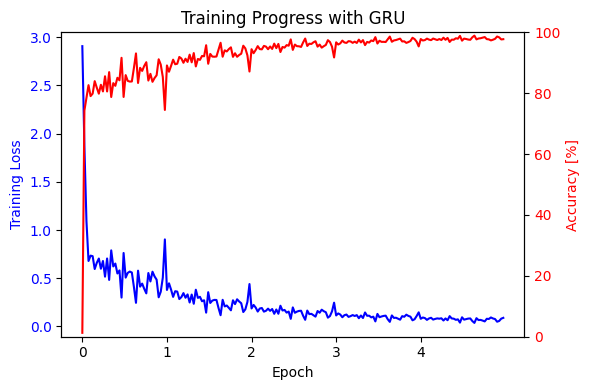

Baseline accuracy: 88.2%
Test accuracy with GRU: 97.3%
Baseline Accuracy is: 88.2%


=== Extension1: RNN=gru, Language=es_gsd ===
Loading dataset [universal_dependencies] with config = 'es_gsd'
DatasetDict({
    train: Dataset({
        features: ['idx', 'text', 'tokens', 'lemmas', 'upos', 'xpos', 'feats', 'head', 'deprel', 'deps', 'misc'],
        num_rows: 14187
    })
    validation: Dataset({
        features: ['idx', 'text', 'tokens', 'lemmas', 'upos', 'xpos', 'feats', 'head', 'deprel', 'deps', 'misc'],
        num_rows: 1400
    })
    test: Dataset({
        features: ['idx', 'text', 'tokens', 'lemmas', 'upos', 'xpos', 'feats', 'head', 'deprel', 'deps', 'misc'],
        num_rows: 426
    })
})
['Además', 'se', 'le', 'pediría', 'a', 'las', 'empresas', 'interesadas', 'en', 'prestar', 'el', 'servicio', 'que', 'se', 'hagan', 'cargo', 'de', 'la', 'señalización', 'y', 'la', 'cartelería', 'que', 'contiene', 'información', 'para', 'los', 'usuarios', '.']
[14, 11, 11, 16, 2, 8, 0, 6, 2, 

Epoch 4 (GRU): 100%|██████████| 50/50 [01:17<00:00,  1.55s/batch, accuracy=98.7, loss=0.0465]


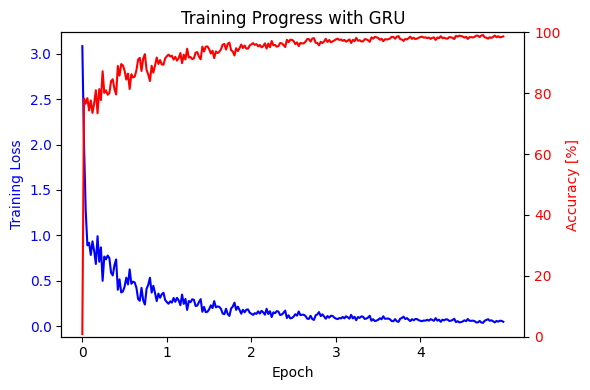

Baseline accuracy: 90.8%
Test accuracy with GRU: 97.2%
Baseline Accuracy is: 90.8%


=== Extension1: RNN=gru, Language=zh_gsdsimp ===
Loading dataset [universal_dependencies] with config = 'zh_gsdsimp'
DatasetDict({
    train: Dataset({
        features: ['idx', 'text', 'tokens', 'lemmas', 'upos', 'xpos', 'feats', 'head', 'deprel', 'deps', 'misc'],
        num_rows: 3997
    })
    validation: Dataset({
        features: ['idx', 'text', 'tokens', 'lemmas', 'upos', 'xpos', 'feats', 'head', 'deprel', 'deps', 'misc'],
        num_rows: 500
    })
    test: Dataset({
        features: ['idx', 'text', 'tokens', 'lemmas', 'upos', 'xpos', 'feats', 'head', 'deprel', 'deps', 'misc'],
        num_rows: 500
    })
})
['看似', '简单', '，', '只', '是', '二', '选', '一', '做', '决择', '，', '但', '其实', '他们', '代表', '的', '是', '你', '周遭', '的', '亲朋', '好友', '，', '试', '着', '给', '你', '不同', '的', '意见', '，', '但', '追根究底', '，', '最后', '决定', '的', '还是', '自己', '。']
[17, 6, 1, 14, 16, 3, 16, 3, 16, 0, 1, 14, 14, 11, 16, 7, 17, 11,

Epoch 4 (GRU): 100%|██████████| 15/15 [00:14<00:00,  1.01batch/s, accuracy=88.7, loss=0.4]


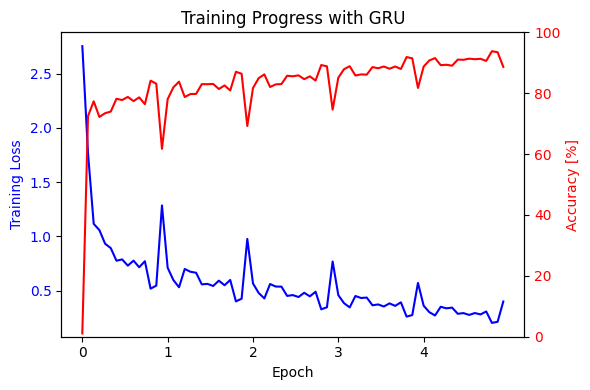

Baseline accuracy: 83.3%
Test accuracy with GRU: 90.0%
Baseline Accuracy is: 83.3%


=== Extension1: RNN=gru, Language=de_gsd ===
Loading dataset [universal_dependencies] with config = 'de_gsd'
DatasetDict({
    train: Dataset({
        features: ['idx', 'text', 'tokens', 'lemmas', 'upos', 'xpos', 'feats', 'head', 'deprel', 'deps', 'misc'],
        num_rows: 13814
    })
    validation: Dataset({
        features: ['idx', 'text', 'tokens', 'lemmas', 'upos', 'xpos', 'feats', 'head', 'deprel', 'deps', 'misc'],
        num_rows: 799
    })
    test: Dataset({
        features: ['idx', 'text', 'tokens', 'lemmas', 'upos', 'xpos', 'feats', 'head', 'deprel', 'deps', 'misc'],
        num_rows: 977
    })
})
['Sehr', 'gute', 'Beratung', ',', 'schnelle', 'Behebung', 'der', 'Probleme', ',', 'so', 'stelle', 'ich', 'mir', 'Kundenservice', 'vor', '.']
[14, 6, 0, 1, 6, 0, 8, 0, 1, 14, 16, 11, 11, 0, 2, 1]
Loaded 13800 sentences
(['Sehr', 'gute', 'Beratung', ',', 'schnelle', 'Behebung', 'der', 'Proble

Epoch 4 (GRU): 100%|██████████| 49/49 [00:53<00:00,  1.10s/batch, accuracy=98.4, loss=0.0586]


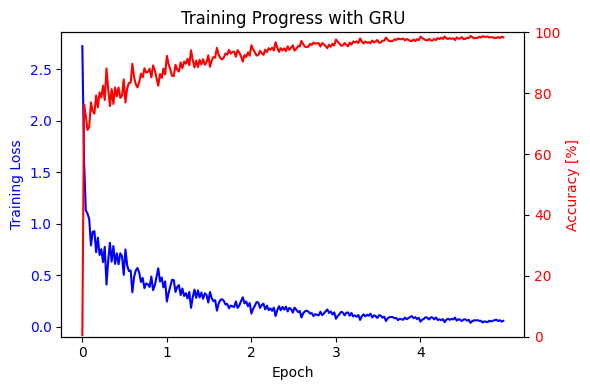

Baseline accuracy: 87.2%
Test accuracy with GRU: 96.6%
Baseline Accuracy is: 87.2%




In [49]:
import torch
import torch.nn as nn
import torch.optim as optim
import numpy as np
from datasets import load_dataset
from sklearn.model_selection import train_test_split
from tqdm import tqdm
import matplotlib.pyplot as plt

class POSTagger:
    def __init__(self, word_embedding_dim=32, hidden_dim=64, batch_size=256, learning_rate=0.01, epochs=5, rnn_type='lstm'):
        self.word_embedding_dim = word_embedding_dim
        self.hidden_dim = hidden_dim
        self.batch_size = batch_size
        self.learning_rate = learning_rate
        self.epochs = epochs
        self.rnn_type = rnn_type.lower()

        if self.rnn_type not in ['lstm', 'gru']:
            raise ValueError("rnn_type must be either 'lstm' or 'gru'")

        self.X = []
        self.y = []
        self.X_train = None
        self.X_test = None
        self.y_train = None
        self.y_test = None

        self.token2idx = None
        self.idx2token = None
        self.tag2idx = None
        self.idx2tag = None

        self.model = None

    def compute_baseline_accuracy(self):
        from collections import defaultdict, Counter

        token2tags = defaultdict(Counter)
        for sentence, tags in zip(self.X_train, self.y_train):
            for tk, tg in zip(sentence, tags):
                token2tags[tk][tg] += 1

        token2best = {}
        global_tag_counter = Counter()
        for tk, c in token2tags.items():
          best_tag, _ = c.most_common(1)[0]
          token2best[tk] = best_tag
          global_tag_counter.update(c.keys())
        global_most_common_tag, _ = global_tag_counter.most_common(1)[0]


        n_total = 0
        n_correct = 0
        for sentence, tags in zip(self.X_test, self.y_test):
          for tk, tg in zip(sentence, tags):
            if tk == "<PAD>":
                continue
            if tk in token2best:
                pred = token2best[tk]
            else:
                pred = global_most_common_tag
            if pred == tg:
                n_correct += 1
            n_total += 1

        baseline_acc = 100.0 * n_correct / n_total if n_total > 0 else 0.0
        print(f"Baseline accuracy: {baseline_acc:.1f}%")
        return baseline_acc


    def load_data(self, language="en_ewt"):
        print(f"Loading dataset [universal_dependencies] with config = '{language}'")
        dataset = load_dataset("universal_dependencies", language)

        print(dataset)

        for sentence in dataset['train']:
            tokens = sentence["tokens"]
            tags = sentence["upos"]
            self.X.append(tokens)
            self.y.append(tags)

        assert len(self.X) == len(self.y)

        print(self.X[0])
        print(self.y[0])


        sentences = [sentence for sentence in zip(self.X, self.y) if len(sentence[0]) > 2]
        self.X = [s[0] for s in sentences]
        self.y = [s[1] for s in sentences]

        print("Loaded %i sentences" % len(sentences))
        print(sentences[0])


        self.X_train, self.X_test, self.y_train, self.y_test = train_test_split(
            self.X, self.y, test_size=0.1, random_state=0
        )

        assert len(self.X_train) == len(self.y_train)
        assert len(self.X_test) == len(self.y_test)
        assert len(self.X_train) + len(self.X_test) == len(self.X)

        print("The training set includes %i sentences" % len(self.X_train))
        print("The test set includes %i sentences" % len(self.X_test))

    def create_vocabulary(self):

        tokens = set()
        upos = set()


        for sentence in self.X_train:
            for token in sentence:
                tokens.add(token)

        for tags in self.y_train:
            for tag in tags:
                upos.add(tag)


        self.idx2token = list(tokens)
        self.idx2token.insert(0, '<UNK>')
        self.idx2token.append('<PAD>')
        self.token2idx = {token: idx for idx, token in enumerate(self.idx2token)}

        self.idx2tag = list(upos)
        self.idx2tag.append('<PAD>')
        self.tag2idx = {tag: idx for idx, tag in enumerate(self.idx2tag)}


        print("Token to Index Mapping:", self.token2idx)
        print("Index to Token Mapping:", self.idx2token)
        print("Tag to Index Mapping:", self.tag2idx)
        print("Index to Tag Mapping:", self.idx2tag)

    def pad_and_encode(self, sentences, labels):
      assert all(len(s) == len(l) for s, l in zip(sentences, labels))
      max_sentence_length = np.max([len(sentence) for sentence in sentences])

      padded_sentences = torch.zeros(len(sentences), max_sentence_length, dtype=torch.long)   # Use dict.get(token, token2idx["<UNK>"]) to handle out-of-vocabulary (OOV) tokens.
                                                                                              # If a token is not in the vocabulary, it automatically defaults to the <UNK> index.
      padded_labels = torch.zeros(len(sentences), max_sentence_length, dtype=torch.long)

      for i, (sentence, tags) in enumerate(zip(sentences, labels)):
        for j, token in enumerate(sentence):
            padded_sentences[i, j] = self.token2idx.get(token, self.token2idx["<UNK>"])

        for j, tag in enumerate(tags):
            padded_labels[i, j] = self.tag2idx[tag]

      return padded_sentences, padded_labels


    def batch_iterator(self, sentences, labels, batch_size=64):
        assert len(sentences) == len(labels)
        for i in range(0, len(sentences), batch_size):
            X, y = self.pad_and_encode(
                sentences[i:min(i+batch_size, len(sentences))],
                labels[i:min(i+batch_size, len(sentences))]
            )
            if torch.cuda.is_available():
                yield (X.cuda(), y.cuda())
            else:
                yield (X, y)

    def initialize_model(self):
        self.model = RNNTagger(
            word_embedding_dim=self.word_embedding_dim,
            hidden_dim=self.hidden_dim,
            vocabulary_size=len(self.token2idx),
            tagset_size=len(self.tag2idx)-1,
            token2idx=self.token2idx,
            tag2idx=self.tag2idx,
            rnn_type=self.rnn_type
        )
        print(self.model)

    def train(self):
        loss_function = nn.NLLLoss(ignore_index=self.tag2idx['<PAD>'])
        optimizer = torch.optim.Adam(self.model.parameters(), lr=self.learning_rate)

        for epoch in range(self.epochs):
            with tqdm(
                self.batch_iterator(self.X_train, self.y_train, batch_size=self.batch_size),
                total=len(self.X_train)//self.batch_size+1, unit="batch", desc=f"Epoch {epoch} ({self.rnn_type.upper()})"
            ) as batches:
                for inputs, targets in batches:
                    self.model.zero_grad()
                    scores = self.model(inputs)
                    loss = loss_function(
                        scores.view(-1, self.model.tagset_size_),
                        targets.view(-1)
                    )
                    loss.backward()
                    optimizer.step()

                    predictions = scores.argmax(dim=2, keepdim=True).squeeze()
                    mask = targets != self.tag2idx['<PAD>']
                    correct = (predictions[mask] == targets[mask]).sum().item()
                    accuracy = correct / mask.sum().item() * 100
                    self.model.training_accuracy_.append(accuracy)
                    self.model.training_loss_.append(loss.item())
                    batches.set_postfix(loss=loss.item(), accuracy=accuracy)

    def plot_training_progress(self):
        fig = plt.figure(figsize=(6, 4))
        ax = plt.subplot()
        ax.set_title(f"Training Progress with {self.rnn_type.upper()}")
        ax.plot(self.model.training_loss_, 'b-')
        ax.set_ylabel("Training Loss", color='b')
        ax.set_xlabel("Epoch")
        ax.tick_params(axis='y', labelcolor='b')
        ax = ax.twinx()
        ax.plot(self.model.training_accuracy_, 'r-')
        ax.set_ylabel("Accuracy [%]", color='r')
        ax.tick_params(axis='y', labelcolor='r')
        a = list(ax.axis())
        a[2] = 0
        a[3] = 100
        ax.axis(a)
        t = np.arange(0, len(self.model.training_accuracy_), len(self.X_train)//self.batch_size+1)
        ax.set_xticks(ticks=t)
        ax.set_xticklabels(labels=np.arange(len(t)))
        fig.tight_layout()
        plt.show()

    def evaluate(self):
        baseline_acc = self.compute_baseline_accuracy()
        with torch.no_grad():
            n_correct = 0
            n_total = 0
            for inputs, targets in self.batch_iterator(self.X_test, self.y_test, batch_size=self.batch_size):
                scores = self.model(inputs)
                predictions = scores.argmax(dim=2, keepdim=True).squeeze()
                mask = targets != self.tag2idx['<PAD>']
                n_correct += (predictions[mask] == targets[mask]).sum().item()
                n_total += mask.sum().item()
        print(f"Test accuracy with {self.rnn_type.upper()}: {100*n_correct/n_total:.1f}%")
        print(f"Baseline Accuracy is: {baseline_acc:.1f}%")

    def run(self, language="en_ewt"):
        self.load_data(language=language)
        self.create_vocabulary()
        self.initialize_model()
        self.train()
        self.plot_training_progress()
        self.evaluate()


class RNNTagger(nn.Module):
    def __init__(self, word_embedding_dim, hidden_dim, vocabulary_size, tagset_size, token2idx, tag2idx, rnn_type='lstm'):
        super(RNNTagger, self).__init__()
        self.hidden_dim_ = hidden_dim
        self.vocabulary_size_ = vocabulary_size
        self.tagset_size_ = tagset_size
        self.token2idx = token2idx
        self.rnn_type = rnn_type.lower()

        self._word_embedding = nn.Embedding(
            num_embeddings=vocabulary_size,
            embedding_dim=word_embedding_dim,
            padding_idx=token2idx['<PAD>']
        )


        if self.rnn_type == 'lstm':
            self._rnn = nn.LSTM(
                input_size=word_embedding_dim,
                hidden_size=hidden_dim,
                batch_first=True
            )
        elif self.rnn_type == 'gru':
            self._rnn = nn.GRU(
                input_size=word_embedding_dim,
                hidden_size=hidden_dim,
                batch_first=True
            )

        self._fc = nn.Linear(hidden_dim, tagset_size)
        self._softmax = nn.LogSoftmax(dim=1)

        self.training_loss_ = list()
        self.training_accuracy_ = list()

        if torch.cuda.is_available():
            self.cuda()

    def forward(self, padded_sentences):
        """The forward pass through the network"""
        batch_size, max_sentence_length = padded_sentences.size()

        embedded_sentences = self._word_embedding(padded_sentences)

        sentence_lengths = (padded_sentences != self.token2idx['<PAD>']).sum(dim=1)
        sentence_lengths = sentence_lengths.long().cpu()

        X = nn.utils.rnn.pack_padded_sequence(
            embedded_sentences,
            sentence_lengths,
            batch_first=True,
            enforce_sorted=False
        )

        rnn_out, _ = self._rnn(X)
        X, _ = nn.utils.rnn.pad_packed_sequence(rnn_out, batch_first=True)

        X = X.contiguous().view(-1, X.shape[2])
        tag_space = self._fc(X)
        tag_scores = self._softmax(tag_space)

        return tag_scores.view(batch_size, max_sentence_length, self.tagset_size_)



if __name__ == "__main__":
    rnn_type = 'gru'

    languages = ["en_ewt", "es_gsd", "zh_gsdsimp", "de_gsd"]
    for lang in languages:
        print(f"=== Extension1: RNN={rnn_type}, Language={lang} ===")
        pos_tagger = POSTagger(
            word_embedding_dim=32,
            hidden_dim=64,
            batch_size=256,
            learning_rate=0.01,
            epochs=5,
            rnn_type=rnn_type
        )
        pos_tagger.run(language=lang)
        print("\n")

In these training curves and test results, the models using GRU layers exhibit a good convergence trend across four languages (English, Spanish, Chinese, and German). As the training epochs progress, the training loss drops rapidly, while the accuracy curve rises significantly.

This variation in accuracy may be related to differences in language structure and corpus size. Spanish and English have relatively clear morphological variations and syntactic rules, making it easier for the model to learn stable part-of-speech features, leading to higher accuracy. In contrast, Chinese lacks morphological markers and requires word segmentation, which means the model needs deeper contextual information to accurately distinguish part-of-speech categories, resulting in slightly lower accuracy. Although German belongs to the same Indo-European language family as English, its complex inflectional morphology poses higher demands on the memory and generalization capabilities of RNN models.



 ### Use a bi-directional RNN layer

=== Extension1: RNN=lstm, Language=en_ewt ===
Loading dataset [universal_dependencies] with config = 'en_ewt'
DatasetDict({
    train: Dataset({
        features: ['idx', 'text', 'tokens', 'lemmas', 'upos', 'xpos', 'feats', 'head', 'deprel', 'deps', 'misc'],
        num_rows: 12543
    })
    validation: Dataset({
        features: ['idx', 'text', 'tokens', 'lemmas', 'upos', 'xpos', 'feats', 'head', 'deprel', 'deps', 'misc'],
        num_rows: 2002
    })
    test: Dataset({
        features: ['idx', 'text', 'tokens', 'lemmas', 'upos', 'xpos', 'feats', 'head', 'deprel', 'deps', 'misc'],
        num_rows: 2077
    })
})
['Al', '-', 'Zaman', ':', 'American', 'forces', 'killed', 'Shaikh', 'Abdullah', 'al', '-', 'Ani', ',', 'the', 'preacher', 'at', 'the', 'mosque', 'in', 'the', 'town', 'of', 'Qaim', ',', 'near', 'the', 'Syrian', 'border', '.']
[10, 1, 10, 1, 6, 0, 16, 10, 10, 10, 1, 10, 1, 8, 0, 2, 8, 0, 2, 8, 0, 2, 10, 1, 2, 8, 6, 0, 1]
Loaded 11401 sentences
(['Al', '-', 'Zaman', ':', 'A

Epoch 4 (LSTM, Bidirectional): 100%|██████████| 41/41 [01:35<00:00,  2.34s/batch, accuracy=99.8, loss=0.0267]


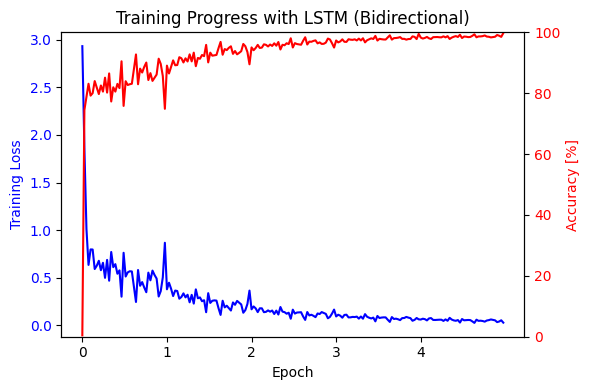

Baseline accuracy: 88.2%
Test accuracy with LSTM (Bidirectional): 97.7%
Baseline Accuracy is: 88.2%


=== Extension1: RNN=lstm, Language=es_gsd ===
Loading dataset [universal_dependencies] with config = 'es_gsd'
DatasetDict({
    train: Dataset({
        features: ['idx', 'text', 'tokens', 'lemmas', 'upos', 'xpos', 'feats', 'head', 'deprel', 'deps', 'misc'],
        num_rows: 14187
    })
    validation: Dataset({
        features: ['idx', 'text', 'tokens', 'lemmas', 'upos', 'xpos', 'feats', 'head', 'deprel', 'deps', 'misc'],
        num_rows: 1400
    })
    test: Dataset({
        features: ['idx', 'text', 'tokens', 'lemmas', 'upos', 'xpos', 'feats', 'head', 'deprel', 'deps', 'misc'],
        num_rows: 426
    })
})
['Además', 'se', 'le', 'pediría', 'a', 'las', 'empresas', 'interesadas', 'en', 'prestar', 'el', 'servicio', 'que', 'se', 'hagan', 'cargo', 'de', 'la', 'señalización', 'y', 'la', 'cartelería', 'que', 'contiene', 'información', 'para', 'los', 'usuarios', '.']
[14, 11, 11, 1

Epoch 4 (LSTM, Bidirectional): 100%|██████████| 50/50 [03:14<00:00,  3.88s/batch, accuracy=99.1, loss=0.0316]


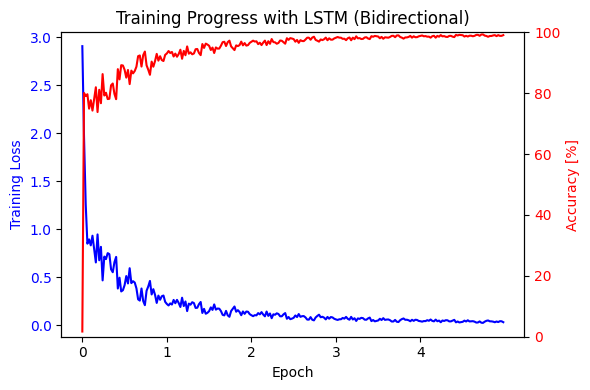

Baseline accuracy: 90.8%
Test accuracy with LSTM (Bidirectional): 97.2%
Baseline Accuracy is: 90.8%


=== Extension1: RNN=lstm, Language=zh_gsdsimp ===
Loading dataset [universal_dependencies] with config = 'zh_gsdsimp'
DatasetDict({
    train: Dataset({
        features: ['idx', 'text', 'tokens', 'lemmas', 'upos', 'xpos', 'feats', 'head', 'deprel', 'deps', 'misc'],
        num_rows: 3997
    })
    validation: Dataset({
        features: ['idx', 'text', 'tokens', 'lemmas', 'upos', 'xpos', 'feats', 'head', 'deprel', 'deps', 'misc'],
        num_rows: 500
    })
    test: Dataset({
        features: ['idx', 'text', 'tokens', 'lemmas', 'upos', 'xpos', 'feats', 'head', 'deprel', 'deps', 'misc'],
        num_rows: 500
    })
})
['看似', '简单', '，', '只', '是', '二', '选', '一', '做', '决择', '，', '但', '其实', '他们', '代表', '的', '是', '你', '周遭', '的', '亲朋', '好友', '，', '试', '着', '给', '你', '不同', '的', '意见', '，', '但', '追根究底', '，', '最后', '决定', '的', '还是', '自己', '。']
[17, 6, 1, 14, 16, 3, 16, 3, 16, 0, 1, 14, 14, 

Epoch 4 (LSTM, Bidirectional): 100%|██████████| 15/15 [00:28<00:00,  1.88s/batch, accuracy=91.3, loss=0.36]


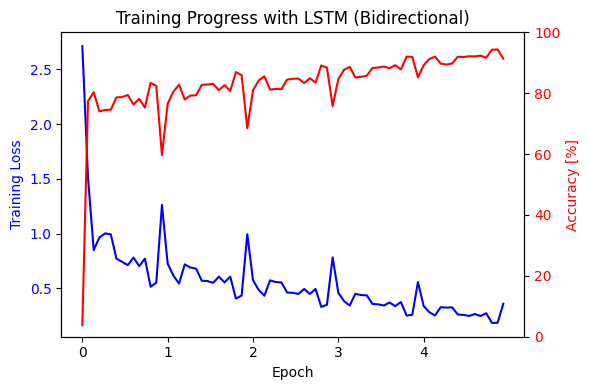

Baseline accuracy: 83.3%
Test accuracy with LSTM (Bidirectional): 90.7%
Baseline Accuracy is: 83.3%


=== Extension1: RNN=lstm, Language=de_gsd ===
Loading dataset [universal_dependencies] with config = 'de_gsd'
DatasetDict({
    train: Dataset({
        features: ['idx', 'text', 'tokens', 'lemmas', 'upos', 'xpos', 'feats', 'head', 'deprel', 'deps', 'misc'],
        num_rows: 13814
    })
    validation: Dataset({
        features: ['idx', 'text', 'tokens', 'lemmas', 'upos', 'xpos', 'feats', 'head', 'deprel', 'deps', 'misc'],
        num_rows: 799
    })
    test: Dataset({
        features: ['idx', 'text', 'tokens', 'lemmas', 'upos', 'xpos', 'feats', 'head', 'deprel', 'deps', 'misc'],
        num_rows: 977
    })
})
['Sehr', 'gute', 'Beratung', ',', 'schnelle', 'Behebung', 'der', 'Probleme', ',', 'so', 'stelle', 'ich', 'mir', 'Kundenservice', 'vor', '.']
[14, 6, 0, 1, 6, 0, 8, 0, 1, 14, 16, 11, 11, 0, 2, 1]
Loaded 13800 sentences
(['Sehr', 'gute', 'Beratung', ',', 'schnelle', 'Behebun

Epoch 4 (LSTM, Bidirectional): 100%|██████████| 49/49 [01:16<00:00,  1.57s/batch, accuracy=98.8, loss=0.0409]


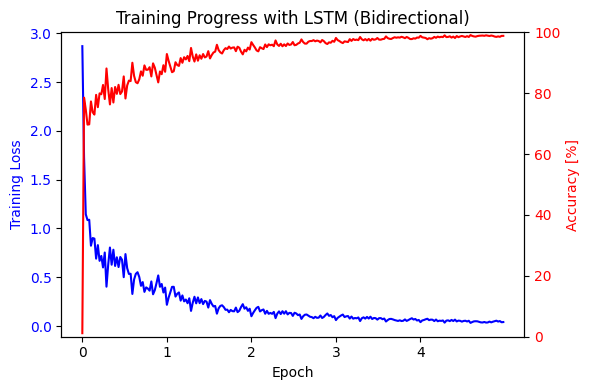

Baseline accuracy: 87.2%
Test accuracy with LSTM (Bidirectional): 96.6%
Baseline Accuracy is: 87.2%




In [53]:
import torch
import torch.nn as nn
import torch.optim as optim
import numpy as np
from datasets import load_dataset
from sklearn.model_selection import train_test_split
from tqdm import tqdm
import matplotlib.pyplot as plt

class POSTagger:
    def __init__(self, word_embedding_dim=32, hidden_dim=64, batch_size=256, learning_rate=0.01, epochs=5, rnn_type='lstm', bidirectional=True):
        self.word_embedding_dim = word_embedding_dim
        self.hidden_dim = hidden_dim
        self.batch_size = batch_size
        self.learning_rate = learning_rate
        self.epochs = epochs
        self.rnn_type = rnn_type.lower()
        self.bidirectional = bidirectional
        if self.rnn_type not in ['lstm', 'gru']:
            raise ValueError("rnn_type must be either 'lstm' or 'gru'")

        self.X = []
        self.y = []
        self.X_train = None
        self.X_test = None
        self.y_train = None
        self.y_test = None

        self.token2idx = None
        self.idx2token = None
        self.tag2idx = None
        self.idx2tag = None

        self.model = None

    def compute_baseline_accuracy(self):
        from collections import defaultdict, Counter
        token2tags = defaultdict(Counter)
        for sentence, tags in zip(self.X_train, self.y_train):
            for tk, tg in zip(sentence, tags):
                token2tags[tk][tg] += 1

        token2best = {}
        global_tag_counter = Counter()
        for tk, c in token2tags.items():
          best_tag, _ = c.most_common(1)[0]
          token2best[tk] = best_tag
          global_tag_counter.update(c.keys())

        global_most_common_tag, _ = global_tag_counter.most_common(1)[0]

        n_total = 0
        n_correct = 0
        for sentence, tags in zip(self.X_test, self.y_test):
          for tk, tg in zip(sentence, tags):
            if tk == "<PAD>":
                continue
            if tk in token2best:
                pred = token2best[tk]
            else:
                pred = global_most_common_tag
            if pred == tg:
                n_correct += 1
            n_total += 1

        baseline_acc = 100.0 * n_correct / n_total if n_total > 0 else 0.0
        print(f"Baseline accuracy: {baseline_acc:.1f}%")
        return baseline_acc

    def load_data(self, language="en_ewt"):
        print(f"Loading dataset [universal_dependencies] with config = '{language}'")
        dataset = load_dataset("universal_dependencies", language)

        print(dataset)

        for sentence in dataset['train']:
            tokens = sentence["tokens"]
            tags = sentence["upos"]
            self.X.append(tokens)
            self.y.append(tags)

        assert len(self.X) == len(self.y)

        print(self.X[0])
        print(self.y[0])


        sentences = [sentence for sentence in zip(self.X, self.y) if len(sentence[0]) > 2]
        self.X = [s[0] for s in sentences]
        self.y = [s[1] for s in sentences]

        print("Loaded %i sentences" % len(sentences))
        print(sentences[0])


        self.X_train, self.X_test, self.y_train, self.y_test = train_test_split(
            self.X, self.y, test_size=0.1, random_state=0
        )

        assert len(self.X_train) == len(self.y_train)
        assert len(self.X_test) == len(self.y_test)
        assert len(self.X_train) + len(self.X_test) == len(self.X)

        print("The training set includes %i sentences" % len(self.X_train))
        print("The test set includes %i sentences" % len(self.X_test))

    def create_vocabulary(self):

        tokens = set()
        upos = set()


        for sentence in self.X_train:
            for token in sentence:
                tokens.add(token)

        for tags in self.y_train:
            for tag in tags:
                upos.add(tag)


        self.idx2token = list(tokens)
        self.idx2token.insert(0, '<UNK>')
        self.idx2token.append('<PAD>')
        self.token2idx = {token: idx for idx, token in enumerate(self.idx2token)}

        self.idx2tag = list(upos)
        self.idx2tag.append('<PAD>')
        self.tag2idx = {tag: idx for idx, tag in enumerate(self.idx2tag)}


        print("Token to Index Mapping:", self.token2idx)
        print("Index to Token Mapping:", self.idx2token)
        print("Tag to Index Mapping:", self.tag2idx)
        print("Index to Tag Mapping:", self.idx2tag)

    def pad_and_encode(self, sentences, labels):
      assert all(len(s) == len(l) for s, l in zip(sentences, labels))
      max_sentence_length = np.max([len(sentence) for sentence in sentences])

      padded_sentences = torch.zeros(len(sentences), max_sentence_length, dtype=torch.long)
      padded_labels = torch.zeros(len(sentences), max_sentence_length, dtype=torch.long)      # Use dict.get(token, token2idx["<UNK>"]) to handle out-of-vocabulary (OOV) tokens.
                                                                                              # If a token is not in the vocabulary, it automatically defaults to the <UNK> index.

      for i, (sentence, tags) in enumerate(zip(sentences, labels)):
        for j, token in enumerate(sentence):
            padded_sentences[i, j] = self.token2idx.get(token, self.token2idx["<UNK>"])

        for j, tag in enumerate(tags):
            padded_labels[i, j] = self.tag2idx[tag]

      return padded_sentences, padded_labels

    def batch_iterator(self, sentences, labels, batch_size=64):
        assert len(sentences) == len(labels)
        for i in range(0, len(sentences), batch_size):
            X, y = self.pad_and_encode(
                sentences[i:min(i+batch_size, len(sentences))],
                labels[i:min(i+batch_size, len(sentences))]
            )
            if torch.cuda.is_available():
                yield (X.cuda(), y.cuda())
            else:
                yield (X, y)

    def initialize_model(self):
        self.model = RNNTagger(
            word_embedding_dim=self.word_embedding_dim,
            hidden_dim=self.hidden_dim,
            vocabulary_size=len(self.token2idx),
            tagset_size=len(self.tag2idx)-1,
            token2idx=self.token2idx,
            tag2idx=self.tag2idx,
            rnn_type=self.rnn_type,
            bidirectional=self.bidirectional
        )
        print(self.model)

    def train(self):
        loss_function = nn.NLLLoss(ignore_index=self.tag2idx['<PAD>'])
        optimizer = torch.optim.Adam(self.model.parameters(), lr=self.learning_rate)

        for epoch in range(self.epochs):
            with tqdm(
                self.batch_iterator(self.X_train, self.y_train, batch_size=self.batch_size),
                total=len(self.X_train)//self.batch_size+1, unit="batch",
                desc=f"Epoch {epoch} ({self.rnn_type.upper()}, {'Bi' if self.bidirectional else 'Uni'}directional)"
            ) as batches:
                for inputs, targets in batches:
                    self.model.zero_grad()
                    scores = self.model(inputs)
                    loss = loss_function(
                        scores.view(-1, self.model.tagset_size_),
                        targets.view(-1)
                    )
                    loss.backward()
                    optimizer.step()

                    predictions = scores.argmax(dim=2, keepdim=True).squeeze()
                    mask = targets != self.tag2idx['<PAD>']
                    correct = (predictions[mask] == targets[mask]).sum().item()
                    accuracy = correct / mask.sum().item() * 100
                    self.model.training_accuracy_.append(accuracy)
                    self.model.training_loss_.append(loss.item())
                    batches.set_postfix(loss=loss.item(), accuracy=accuracy)

    def plot_training_progress(self):
        fig = plt.figure(figsize=(6, 4))
        ax = plt.subplot()
        direction = 'Bidirectional' if self.bidirectional else 'Unidirectional'
        ax.set_title(f"Training Progress with {self.rnn_type.upper()} ({direction})")
        ax.plot(self.model.training_loss_, 'b-')
        ax.set_ylabel("Training Loss", color='b')
        ax.set_xlabel("Epoch")
        ax.tick_params(axis='y', labelcolor='b')
        ax = ax.twinx()
        ax.plot(self.model.training_accuracy_, 'r-')
        ax.set_ylabel("Accuracy [%]", color='r')
        ax.tick_params(axis='y', labelcolor='r')
        a = list(ax.axis())
        a[2] = 0
        a[3] = 100
        ax.axis(a)
        t = np.arange(0, len(self.model.training_accuracy_), len(self.X_train)//self.batch_size+1)
        ax.set_xticks(ticks=t)
        ax.set_xticklabels(labels=np.arange(len(t)))
        fig.tight_layout()
        plt.show()

    def evaluate(self):
        baseline_acc = self.compute_baseline_accuracy()
        with torch.no_grad():
            n_correct = 0
            n_total = 0
            for inputs, targets in self.batch_iterator(self.X_test, self.y_test, batch_size=self.batch_size):
                scores = self.model(inputs)
                predictions = scores.argmax(dim=2, keepdim=True).squeeze()
                mask = targets != self.tag2idx['<PAD>']
                n_correct += (predictions[mask] == targets[mask]).sum().item()
                n_total += mask.sum().item()

        direction = 'Bidirectional' if self.bidirectional else 'Unidirectional'
        print(f"Test accuracy with {self.rnn_type.upper()} ({direction}): {100*n_correct/n_total:.1f}%")
        print(f"Baseline Accuracy is: {baseline_acc:.1f}%")

    def run(self, language="en_ewt"):
        self.load_data(language=language)
        self.create_vocabulary()
        self.initialize_model()
        self.train()
        self.plot_training_progress()
        self.evaluate()


class RNNTagger(nn.Module):
    def __init__(self, word_embedding_dim, hidden_dim, vocabulary_size, tagset_size, token2idx, tag2idx, rnn_type='lstm', bidirectional=True):
        super(RNNTagger, self).__init__()
        self.hidden_dim_ = hidden_dim
        self.vocabulary_size_ = vocabulary_size
        self.tagset_size_ = tagset_size
        self.token2idx = token2idx
        self.rnn_type = rnn_type.lower()
        self.bidirectional = bidirectional

        self._word_embedding = nn.Embedding(
            num_embeddings=vocabulary_size,
            embedding_dim=word_embedding_dim,
            padding_idx=token2idx['<PAD>']
        )


        self.num_directions = 2 if bidirectional else 1


        if self.rnn_type == 'lstm':
            self._rnn = nn.LSTM(
                input_size=word_embedding_dim,
                hidden_size=hidden_dim,
                batch_first=True,
                bidirectional=bidirectional
            )
        elif self.rnn_type == 'gru':
            self._rnn = nn.GRU(
                input_size=word_embedding_dim,
                hidden_size=hidden_dim,
                batch_first=True,
                bidirectional=bidirectional
            )


        rnn_output_dim = hidden_dim * self.num_directions

        self._fc = nn.Linear(rnn_output_dim, tagset_size)
        self._softmax = nn.LogSoftmax(dim=1)

        self.training_loss_ = list()
        self.training_accuracy_ = list()

        if torch.cuda.is_available():
            self.cuda()

    def forward(self, padded_sentences):
        batch_size, max_sentence_length = padded_sentences.size()

        embedded_sentences = self._word_embedding(padded_sentences)

        sentence_lengths = (padded_sentences != self.token2idx['<PAD>']).sum(dim=1)
        sentence_lengths = sentence_lengths.long().cpu()

        X = nn.utils.rnn.pack_padded_sequence(
            embedded_sentences,
            sentence_lengths,
            batch_first=True,
            enforce_sorted=False
        )

        rnn_out, _ = self._rnn(X)
        X, _ = nn.utils.rnn.pad_packed_sequence(rnn_out, batch_first=True)

        X = X.contiguous().view(-1, X.shape[2])
        tag_space = self._fc(X)
        tag_scores = self._softmax(tag_space)

        return tag_scores.view(batch_size, max_sentence_length, self.tagset_size_)


if __name__ == "__main__":
    rnn_type = 'lstm'
    bidirectional = True

    languages = ["en_ewt", "es_gsd", "zh_gsdsimp", "de_gsd"]
    for lang in languages:
        print(f"=== Extension1: RNN={rnn_type}, Language={lang} ===")
        pos_tagger = POSTagger(
            word_embedding_dim=32,
            hidden_dim=64,
            batch_size=256,
            learning_rate=0.01,
            epochs=5,
            rnn_type=rnn_type
        )
        pos_tagger.run(language=lang)
        print("\n")

In this experiment, we used a Bidirectional LSTM (BiLSTM) model for part-of-speech tagging on English, Spanish, Chinese, and German. It can be observed that English and Spanish achieve relatively higher accuracy, which may be attributed to their more regular morphological variations and word order characteristics, making it easier for the model to extract relevant features. German also achieves a good performance, but due to its complex inflectional morphology, the model requires stronger capabilities to capture case inflections and word order information.

The accuracy for Chinese is noticeably lower, indicating that despite BiLSTM’s ability to capture bidirectional context, it still struggles with Chinese features, particularly in the absence of explicit morphological markers and the ambiguity introduced by word segmentation. Additionally, differences in dataset sizes and annotation standards across languages also affect the model’s learning performance.

### Use pyTorch's Dataset

=== Extension1: RNN=lstm, Language=en_ewt ===
Loading dataset [universal_dependencies] with config = 'en_ewt'
DatasetDict({
    train: Dataset({
        features: ['idx', 'text', 'tokens', 'lemmas', 'upos', 'xpos', 'feats', 'head', 'deprel', 'deps', 'misc'],
        num_rows: 12543
    })
    validation: Dataset({
        features: ['idx', 'text', 'tokens', 'lemmas', 'upos', 'xpos', 'feats', 'head', 'deprel', 'deps', 'misc'],
        num_rows: 2002
    })
    test: Dataset({
        features: ['idx', 'text', 'tokens', 'lemmas', 'upos', 'xpos', 'feats', 'head', 'deprel', 'deps', 'misc'],
        num_rows: 2077
    })
})
['Al', '-', 'Zaman', ':', 'American', 'forces', 'killed', 'Shaikh', 'Abdullah', 'al', '-', 'Ani', ',', 'the', 'preacher', 'at', 'the', 'mosque', 'in', 'the', 'town', 'of', 'Qaim', ',', 'near', 'the', 'Syrian', 'border', '.']
[10, 1, 10, 1, 6, 0, 16, 10, 10, 10, 1, 10, 1, 8, 0, 2, 8, 0, 2, 8, 0, 2, 10, 1, 2, 8, 6, 0, 1]
Loaded 11401 sentences
(['Al', '-', 'Zaman', ':', 'A

Epoch 1/5 (LSTM, Unidirectional): 100%|██████████| 41/41 [00:10<00:00,  3.90batch/s, accuracy=87.96%, loss=1.8158]


Epoch 1/5 - Loss: 2.3778, Accuracy: 70.12%


Epoch 2/5 (LSTM, Unidirectional): 100%|██████████| 41/41 [00:10<00:00,  4.02batch/s, accuracy=94.19%, loss=1.2777]


Epoch 2/5 - Loss: 1.6123, Accuracy: 94.64%


Epoch 3/5 (LSTM, Unidirectional): 100%|██████████| 41/41 [00:11<00:00,  3.73batch/s, accuracy=94.83%, loss=0.8520]


Epoch 3/5 - Loss: 1.0895, Accuracy: 96.73%


Epoch 4/5 (LSTM, Unidirectional): 100%|██████████| 41/41 [00:11<00:00,  3.65batch/s, accuracy=96.67%, loss=0.5335]


Epoch 4/5 - Loss: 0.7274, Accuracy: 97.76%


Epoch 5/5 (LSTM, Unidirectional): 100%|██████████| 41/41 [00:11<00:00,  3.68batch/s, accuracy=97.60%, loss=0.3840]


Epoch 5/5 - Loss: 0.4928, Accuracy: 98.32%


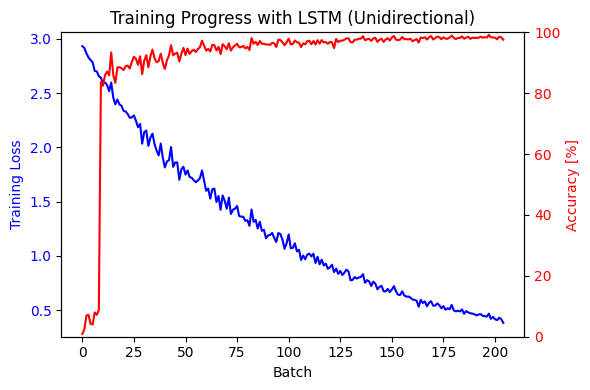

Evaluating: 100%|██████████| 5/5 [00:00<00:00, 24.41batch/s]


Test accuracy with LSTM (Unidirectional): 97.19%


=== Extension1: RNN=lstm, Language=es_gsd ===
Loading dataset [universal_dependencies] with config = 'es_gsd'
DatasetDict({
    train: Dataset({
        features: ['idx', 'text', 'tokens', 'lemmas', 'upos', 'xpos', 'feats', 'head', 'deprel', 'deps', 'misc'],
        num_rows: 14187
    })
    validation: Dataset({
        features: ['idx', 'text', 'tokens', 'lemmas', 'upos', 'xpos', 'feats', 'head', 'deprel', 'deps', 'misc'],
        num_rows: 1400
    })
    test: Dataset({
        features: ['idx', 'text', 'tokens', 'lemmas', 'upos', 'xpos', 'feats', 'head', 'deprel', 'deps', 'misc'],
        num_rows: 426
    })
})
['Además', 'se', 'le', 'pediría', 'a', 'las', 'empresas', 'interesadas', 'en', 'prestar', 'el', 'servicio', 'que', 'se', 'hagan', 'cargo', 'de', 'la', 'señalización', 'y', 'la', 'cartelería', 'que', 'contiene', 'información', 'para', 'los', 'usuarios', '.']
[14, 11, 11, 16, 2, 8, 0, 6, 2, 16, 8, 0, 5, 11, 16, 0, 2, 8, 0, 

Epoch 1/5 (LSTM, Unidirectional): 100%|██████████| 50/50 [00:24<00:00,  2.03batch/s, accuracy=92.18%, loss=1.6410]


Epoch 1/5 - Loss: 2.1582, Accuracy: 79.67%


Epoch 2/5 (LSTM, Unidirectional): 100%|██████████| 50/50 [00:24<00:00,  2.03batch/s, accuracy=95.16%, loss=0.9893]


Epoch 2/5 - Loss: 1.3306, Accuracy: 95.02%


Epoch 3/5 (LSTM, Unidirectional): 100%|██████████| 50/50 [00:25<00:00,  1.96batch/s, accuracy=96.91%, loss=0.6292]


Epoch 3/5 - Loss: 0.8239, Accuracy: 97.24%


Epoch 4/5 (LSTM, Unidirectional): 100%|██████████| 50/50 [00:27<00:00,  1.83batch/s, accuracy=98.52%, loss=0.4302]


Epoch 4/5 - Loss: 0.5020, Accuracy: 98.12%


Epoch 5/5 (LSTM, Unidirectional): 100%|██████████| 50/50 [00:25<00:00,  1.97batch/s, accuracy=98.38%, loss=0.2691]


Epoch 5/5 - Loss: 0.3257, Accuracy: 98.70%


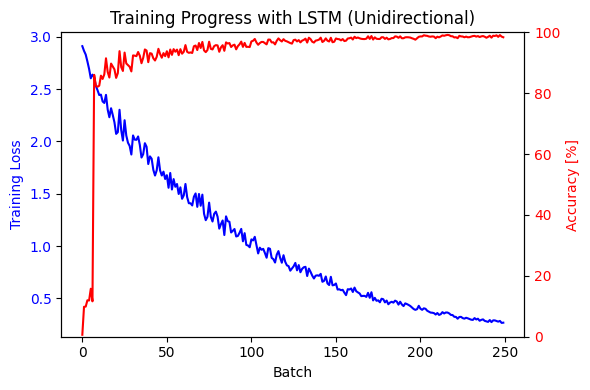

Evaluating: 100%|██████████| 6/6 [00:00<00:00, 11.98batch/s]


Test accuracy with LSTM (Unidirectional): 97.84%


=== Extension1: RNN=lstm, Language=zh_gsdsimp ===
Loading dataset [universal_dependencies] with config = 'zh_gsdsimp'
DatasetDict({
    train: Dataset({
        features: ['idx', 'text', 'tokens', 'lemmas', 'upos', 'xpos', 'feats', 'head', 'deprel', 'deps', 'misc'],
        num_rows: 3997
    })
    validation: Dataset({
        features: ['idx', 'text', 'tokens', 'lemmas', 'upos', 'xpos', 'feats', 'head', 'deprel', 'deps', 'misc'],
        num_rows: 500
    })
    test: Dataset({
        features: ['idx', 'text', 'tokens', 'lemmas', 'upos', 'xpos', 'feats', 'head', 'deprel', 'deps', 'misc'],
        num_rows: 500
    })
})
['看似', '简单', '，', '只', '是', '二', '选', '一', '做', '决择', '，', '但', '其实', '他们', '代表', '的', '是', '你', '周遭', '的', '亲朋', '好友', '，', '试', '着', '给', '你', '不同', '的', '意见', '，', '但', '追根究底', '，', '最后', '决定', '的', '还是', '自己', '。']
[17, 6, 1, 14, 16, 3, 16, 3, 16, 0, 1, 14, 14, 11, 16, 7, 17, 11, 0, 7, 0, 0, 1, 16, 7, 16, 11, 6,

Epoch 1/5 (LSTM, Unidirectional): 100%|██████████| 15/15 [00:05<00:00,  2.91batch/s, accuracy=77.19%, loss=2.1375]


Epoch 1/5 - Loss: 2.4158, Accuracy: 58.98%


Epoch 2/5 (LSTM, Unidirectional): 100%|██████████| 15/15 [00:05<00:00,  2.81batch/s, accuracy=77.33%, loss=1.7864]


Epoch 2/5 - Loss: 2.0492, Accuracy: 84.14%


Epoch 3/5 (LSTM, Unidirectional): 100%|██████████| 15/15 [00:05<00:00,  2.87batch/s, accuracy=87.44%, loss=1.5964]


Epoch 3/5 - Loss: 1.7797, Accuracy: 88.37%


Epoch 4/5 (LSTM, Unidirectional): 100%|██████████| 15/15 [00:05<00:00,  2.90batch/s, accuracy=81.88%, loss=1.3235]


Epoch 4/5 - Loss: 1.5172, Accuracy: 91.37%


Epoch 5/5 (LSTM, Unidirectional): 100%|██████████| 15/15 [00:05<00:00,  2.74batch/s, accuracy=92.59%, loss=1.0743]


Epoch 5/5 - Loss: 1.2905, Accuracy: 93.53%


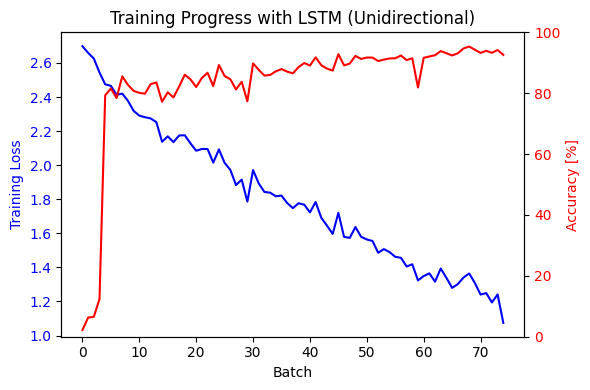

Evaluating: 100%|██████████| 2/2 [00:00<00:00, 19.15batch/s]


Test accuracy with LSTM (Unidirectional): 92.36%


=== Extension1: RNN=lstm, Language=de_gsd ===
Loading dataset [universal_dependencies] with config = 'de_gsd'
DatasetDict({
    train: Dataset({
        features: ['idx', 'text', 'tokens', 'lemmas', 'upos', 'xpos', 'feats', 'head', 'deprel', 'deps', 'misc'],
        num_rows: 13814
    })
    validation: Dataset({
        features: ['idx', 'text', 'tokens', 'lemmas', 'upos', 'xpos', 'feats', 'head', 'deprel', 'deps', 'misc'],
        num_rows: 799
    })
    test: Dataset({
        features: ['idx', 'text', 'tokens', 'lemmas', 'upos', 'xpos', 'feats', 'head', 'deprel', 'deps', 'misc'],
        num_rows: 977
    })
})
['Sehr', 'gute', 'Beratung', ',', 'schnelle', 'Behebung', 'der', 'Probleme', ',', 'so', 'stelle', 'ich', 'mir', 'Kundenservice', 'vor', '.']
[14, 6, 0, 1, 6, 0, 8, 0, 1, 14, 16, 11, 11, 0, 2, 1]
Loaded 13800 sentences
(['Sehr', 'gute', 'Beratung', ',', 'schnelle', 'Behebung', 'der', 'Probleme', ',', 'so', 'stelle', 'ich', 

Epoch 1/5 (LSTM, Unidirectional): 100%|██████████| 49/49 [00:13<00:00,  3.61batch/s, accuracy=89.36%, loss=1.6110]


Epoch 1/5 - Loss: 2.1361, Accuracy: 76.76%


Epoch 2/5 (LSTM, Unidirectional): 100%|██████████| 49/49 [00:15<00:00,  3.17batch/s, accuracy=93.45%, loss=0.9843]


Epoch 2/5 - Loss: 1.3130, Accuracy: 93.35%


Epoch 3/5 (LSTM, Unidirectional): 100%|██████████| 49/49 [00:14<00:00,  3.46batch/s, accuracy=96.44%, loss=0.6268]


Epoch 3/5 - Loss: 0.8076, Accuracy: 96.08%


Epoch 4/5 (LSTM, Unidirectional): 100%|██████████| 49/49 [00:14<00:00,  3.34batch/s, accuracy=96.71%, loss=0.3872]


Epoch 4/5 - Loss: 0.4997, Accuracy: 97.66%


Epoch 5/5 (LSTM, Unidirectional): 100%|██████████| 49/49 [00:14<00:00,  3.45batch/s, accuracy=98.39%, loss=0.2693]


Epoch 5/5 - Loss: 0.3212, Accuracy: 98.47%


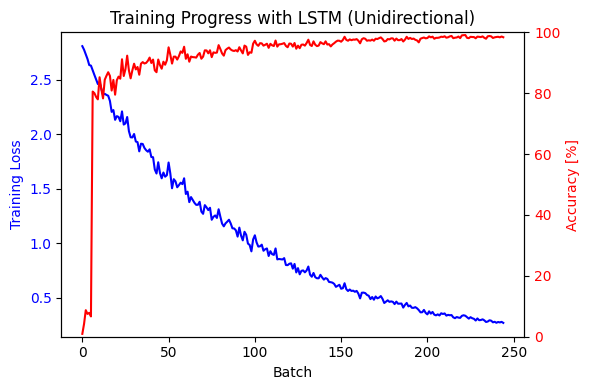

Evaluating: 100%|██████████| 6/6 [00:00<00:00, 14.96batch/s]

Test accuracy with LSTM (Unidirectional): 96.88%




In [51]:
import torch
import torch.nn as nn
import torch.optim as optim
import numpy as np
from torch.utils.data import Dataset, DataLoader
from datasets import load_dataset
from sklearn.model_selection import train_test_split
from tqdm import tqdm
import matplotlib.pyplot as plt


class POSDataset(Dataset):
    def __init__(self, sentences, tags, token2idx, tag2idx):
        self.sentences = sentences
        self.tags = tags
        self.token2idx = token2idx
        self.tag2idx = tag2idx

    def __len__(self):
        return len(self.sentences)

    def __getitem__(self, idx):
        sentence = self.sentences[idx]
        tag_seq = self.tags[idx]


        token_indices = []
        for token in sentence:
            if token in self.token2idx:
                token_indices.append(self.token2idx[token])
            else:
                token_indices.append(self.token2idx['<UNK>'])


        tag_indices = [self.tag2idx[tag] for tag in tag_seq]

        return {
            'sentence': sentence,
            'tag_seq': tag_seq,
            'token_indices': token_indices,
            'tag_indices': tag_indices,
            'length': len(sentence)
        }


def collate_fn(batch):
    batch = sorted(batch, key=lambda x: x['length'], reverse=True)

    max_len = max([item['length'] for item in batch])

    batch_size = len(batch)
    token_indices_batch = torch.zeros(batch_size, max_len, dtype=torch.long)
    tag_indices_batch = torch.zeros(batch_size, max_len, dtype=torch.long)
    lengths = torch.LongTensor([item['length'] for item in batch])

    for i, item in enumerate(batch):
        tokens = torch.tensor(item['token_indices'], dtype=torch.long)
        tags = torch.tensor(item['tag_indices'], dtype=torch.long)
        token_indices_batch[i, :len(tokens)] = tokens
        tag_indices_batch[i, :len(tags)] = tags

    return {
        'token_indices': token_indices_batch,
        'tag_indices': tag_indices_batch,
        'lengths': lengths,
        'sentences': [item['sentence'] for item in batch],
        'tag_seqs': [item['tag_seq'] for item in batch]
    }


class POSTagger:
    def __init__(self, word_embedding_dim=32, hidden_dim=64, batch_size=256, learning_rate=0.01, epochs=5, rnn_type='lstm', bidirectional=False):
        self.word_embedding_dim = word_embedding_dim
        self.hidden_dim = hidden_dim
        self.batch_size = batch_size
        self.learning_rate = learning_rate
        self.epochs = epochs
        self.rnn_type = rnn_type.lower()
        self.bidirectional = bidirectional

        if self.rnn_type not in ['lstm', 'gru']:
            raise ValueError("rnn_type must be either 'lstm' or 'gru'")

        self.X = []
        self.y = []
        self.X_train = None
        self.X_test = None
        self.y_train = None
        self.y_test = None

        self.token2idx = None
        self.idx2token = None
        self.tag2idx = None
        self.idx2tag = None

        self.model = None


        self.train_dataset = None
        self.test_dataset = None
        self.train_loader = None
        self.test_loader = None

    def load_data(self, language="en_ewt"):
        print(f"Loading dataset [universal_dependencies] with config = '{language}'")
        dataset = load_dataset("universal_dependencies", language)

        print(dataset)

        for sentence in dataset['train']:
            tokens = sentence["tokens"]
            tags = sentence["upos"]
            self.X.append(tokens)
            self.y.append(tags)

        assert len(self.X) == len(self.y)

        print(self.X[0])
        print(self.y[0])

        sentences = [sentence for sentence in zip(self.X, self.y) if len(sentence[0]) > 2]
        self.X = [s[0] for s in sentences]
        self.y = [s[1] for s in sentences]

        print("Loaded %i sentences" % len(sentences))
        print(sentences[0])

        self.X_train, self.X_test, self.y_train, self.y_test = train_test_split(
            self.X, self.y, test_size=0.1, random_state=0
        )

        assert len(self.X_train) == len(self.y_train)
        assert len(self.X_test) == len(self.y_test)
        assert len(self.X_train) + len(self.X_test) == len(self.X)

        print("The training set includes %i sentences" % len(self.X_train))
        print("The test set includes %i sentences" % len(self.X_test))

    def create_vocabulary(self):
        tokens = set()
        upos = set()

        for sentence in self.X_train:
            for token in sentence:
                tokens.add(token)

        for tags in self.y_train:
            for tag in tags:
                upos.add(tag)

        self.idx2token = list(tokens)
        self.idx2token.insert(0, '<UNK>')
        self.idx2token.append('<PAD>')
        self.token2idx = {token: idx for idx, token in enumerate(self.idx2token)}

        self.idx2tag = list(upos)
        self.idx2tag.append('<PAD>')
        self.tag2idx = {tag: idx for idx, tag in enumerate(self.idx2tag)}

        print("Token to Index Mapping:", self.token2idx)
        print("Index to Token Mapping:", self.idx2token)
        print("Tag to Index Mapping:", self.tag2idx)
        print("Index to Tag Mapping:", self.idx2tag)

    def setup_dataloaders(self):
        self.train_dataset = POSDataset(
            self.X_train,
            self.y_train,
            self.token2idx,
            self.tag2idx
        )

        self.test_dataset = POSDataset(
            self.X_test,
            self.y_test,
            self.token2idx,
            self.tag2idx
        )

        self.train_loader = DataLoader(
            self.train_dataset,
            batch_size=self.batch_size,
            shuffle=True,
            collate_fn=collate_fn,
            num_workers=0
        )

        self.test_loader = DataLoader(
            self.test_dataset,
            batch_size=self.batch_size,
            shuffle=False,
            collate_fn=collate_fn,
            num_workers=0
        )

        print(f"Created DataLoaders - Training batches: {len(self.train_loader)}, Test batches: {len(self.test_loader)}")

    def initialize_model(self):
        self.model = RNNTagger(
            word_embedding_dim=self.word_embedding_dim,
            hidden_dim=self.hidden_dim,
            vocabulary_size=len(self.token2idx),
            tagset_size=len(self.tag2idx)-1,
            token2idx=self.token2idx,
            tag2idx=self.tag2idx,
            rnn_type=self.rnn_type,
            bidirectional=self.bidirectional
        )
        print(self.model)

    def train(self):
        loss_function = nn.NLLLoss(ignore_index=self.tag2idx['<PAD>'])
        optimizer = torch.optim.Adam(self.model.parameters(), lr=self.learning_rate)

        for epoch in range(self.epochs):
            self.model.train()
            running_loss = 0.0
            running_accuracy = 0.0
            total_predictions = 0

            progress_bar = tqdm(
                self.train_loader,
                desc=f"Epoch {epoch+1}/{self.epochs} ({self.rnn_type.upper()}, {'Bi' if self.bidirectional else 'Uni'}directional)",
                unit="batch"
            )

            for batch in progress_bar:
                token_indices = batch['token_indices']
                tag_indices = batch['tag_indices']
                lengths = batch['lengths']

                if torch.cuda.is_available():
                    token_indices = token_indices.cuda()
                    tag_indices = tag_indices.cuda()


                optimizer.zero_grad()


                scores = self.model(token_indices, lengths)


                loss = loss_function(
                    scores.view(-1, self.model.tagset_size_),
                    tag_indices.view(-1)
                )


                loss.backward()
                optimizer.step()


                predictions = scores.argmax(dim=2, keepdim=True).squeeze()
                mask = tag_indices != self.tag2idx['<PAD>']
                correct = (predictions[mask] == tag_indices[mask]).sum().item()
                total = mask.sum().item()


                running_loss += loss.item()
                running_accuracy += correct
                total_predictions += total


                batch_accuracy = 100 * correct / total if total > 0 else 0
                progress_bar.set_postfix(
                    loss=f"{loss.item():.4f}",
                    accuracy=f"{batch_accuracy:.2f}%"
                )


                self.model.training_loss_.append(loss.item())
                self.model.training_accuracy_.append(batch_accuracy)


            epoch_loss = running_loss / len(self.train_loader)
            epoch_accuracy = 100 * running_accuracy / total_predictions if total_predictions > 0 else 0
            print(f"Epoch {epoch+1}/{self.epochs} - Loss: {epoch_loss:.4f}, Accuracy: {epoch_accuracy:.2f}%")

    def plot_training_progress(self):
        fig = plt.figure(figsize=(6, 4))
        ax = plt.subplot()
        direction = 'Bidirectional' if self.bidirectional else 'Unidirectional'
        ax.set_title(f"Training Progress with {self.rnn_type.upper()} ({direction})")
        ax.plot(self.model.training_loss_, 'b-')
        ax.set_ylabel("Training Loss", color='b')
        ax.set_xlabel("Batch")
        ax.tick_params(axis='y', labelcolor='b')
        ax = ax.twinx()
        ax.plot(self.model.training_accuracy_, 'r-')
        ax.set_ylabel("Accuracy [%]", color='r')
        ax.tick_params(axis='y', labelcolor='r')
        a = list(ax.axis())
        a[2] = 0
        a[3] = 100
        ax.axis(a)
        fig.tight_layout()
        plt.show()

    def evaluate(self):
        self.model.eval()
        n_correct = 0
        n_total = 0

        with torch.no_grad():
            for batch in tqdm(self.test_loader, desc="Evaluating", unit="batch"):

                token_indices = batch['token_indices']
                tag_indices = batch['tag_indices']
                lengths = batch['lengths']

                if torch.cuda.is_available():
                    token_indices = token_indices.cuda()
                    tag_indices = tag_indices.cuda()


                scores = self.model(token_indices, lengths)


                predictions = scores.argmax(dim=2, keepdim=True).squeeze()
                mask = tag_indices != self.tag2idx['<PAD>']
                n_correct += (predictions[mask] == tag_indices[mask]).sum().item()
                n_total += mask.sum().item()

        accuracy = 100 * n_correct / n_total if n_total > 0 else 0
        direction = 'Bidirectional' if self.bidirectional else 'Unidirectional'
        print(f"Test accuracy with {self.rnn_type.upper()} ({direction}): {accuracy:.2f}%")

        return accuracy

    def run(self, language="en_ewt"):
        self.load_data(language=language)
        self.create_vocabulary()
        self.setup_dataloaders()
        self.initialize_model()
        self.train()
        self.plot_training_progress()
        self.evaluate()


class RNNTagger(nn.Module):
    def __init__(self, word_embedding_dim, hidden_dim, vocabulary_size, tagset_size, token2idx, tag2idx, rnn_type='lstm', bidirectional=False):
        super(RNNTagger, self).__init__()
        self.hidden_dim_ = hidden_dim
        self.vocabulary_size_ = vocabulary_size
        self.tagset_size_ = tagset_size
        self.token2idx = token2idx
        self.rnn_type = rnn_type.lower()
        self.bidirectional = bidirectional

        self._word_embedding = nn.Embedding(
            num_embeddings=vocabulary_size,
            embedding_dim=word_embedding_dim,
            padding_idx=token2idx['<PAD>']
        )


        self.num_directions = 2 if bidirectional else 1


        if self.rnn_type == 'lstm':
            self._rnn = nn.LSTM(
                input_size=word_embedding_dim,
                hidden_size=hidden_dim,
                batch_first=True,
                bidirectional=bidirectional
            )
        elif self.rnn_type == 'gru':
            self._rnn = nn.GRU(
                input_size=word_embedding_dim,
                hidden_size=hidden_dim,
                batch_first=True,
                bidirectional=bidirectional
            )


        rnn_output_dim = hidden_dim * self.num_directions

        self._fc = nn.Linear(rnn_output_dim, tagset_size)
        self._softmax = nn.LogSoftmax(dim=1)

        self.training_loss_ = list()
        self.training_accuracy_ = list()

        if torch.cuda.is_available():
            self.cuda()

    def forward(self, padded_sentences, lengths):
        """The forward pass through the network"""
        batch_size, max_sentence_length = padded_sentences.size()

        embedded_sentences = self._word_embedding(padded_sentences)


        X = nn.utils.rnn.pack_padded_sequence(
            embedded_sentences,
            lengths,
            batch_first=True,
            enforce_sorted=True
        )


        rnn_out, _ = self._rnn(X)


        X, _ = nn.utils.rnn.pad_packed_sequence(rnn_out, batch_first=True)

        X = X.contiguous().view(-1, X.shape[2])
        tag_space = self._fc(X)
        tag_scores = self._softmax(tag_space)

        return tag_scores.view(batch_size, max_sentence_length, self.tagset_size_)



if __name__ == "__main__":
    rnn_type = 'lstm'
    bidirectional = True

    languages = ["en_ewt", "es_gsd", "zh_gsdsimp", "de_gsd"]
    for lang in languages:
        print(f"=== Extension1: RNN={rnn_type}, Language={lang} ===")
        pos_tagger = POSTagger(
            word_embedding_dim=32,
            hidden_dim=64,
            batch_size=256,
            learning_rate=0.01,
            epochs=5,
            rnn_type=rnn_type
        )
        pos_tagger.run(language=lang)
        print("\n")

After using the PyTorch Dataset for data loading, the training curves and final accuracy for all four languages performed well: English and Spanish achieved over 97%, German reached 96%+, while Chinese was slightly lower at around 92%.  

Overall, the training loss (blue line) decreased rapidly with the number of batches, and the accuracy (red line) continued to rise, indicating that the model was able to converge stably during mini-batch training. In comparison, English and Spanish exhibit higher morphological or syntactic predictability, making them easier for the model to learn. Chinese, on the other hand, lacks morphological markers and involves word segmentation ambiguities, leading to slightly lower accuracy. German falls between these two but still achieves strong results.  

This experiment demonstrates that with a standardized Dataset/DataLoader processing pipeline, the model can still achieve high accuracy in multilingual part-of-speech tagging tasks.

### Model Complexity Comparison

=== Model Complexity: LowComplex (emb=32, hid=64) ===
--- Language: en_ewt ---
Loading dataset [universal_dependencies] with config = 'en_ewt'
DatasetDict({
    train: Dataset({
        features: ['idx', 'text', 'tokens', 'lemmas', 'upos', 'xpos', 'feats', 'head', 'deprel', 'deps', 'misc'],
        num_rows: 12543
    })
    validation: Dataset({
        features: ['idx', 'text', 'tokens', 'lemmas', 'upos', 'xpos', 'feats', 'head', 'deprel', 'deps', 'misc'],
        num_rows: 2002
    })
    test: Dataset({
        features: ['idx', 'text', 'tokens', 'lemmas', 'upos', 'xpos', 'feats', 'head', 'deprel', 'deps', 'misc'],
        num_rows: 2077
    })
})
['Al', '-', 'Zaman', ':', 'American', 'forces', 'killed', 'Shaikh', 'Abdullah', 'al', '-', 'Ani', ',', 'the', 'preacher', 'at', 'the', 'mosque', 'in', 'the', 'town', 'of', 'Qaim', ',', 'near', 'the', 'Syrian', 'border', '.']
[10, 1, 10, 1, 6, 0, 16, 10, 10, 10, 1, 10, 1, 8, 0, 2, 8, 0, 2, 8, 0, 2, 10, 1, 2, 8, 6, 0, 1]
Loaded 11401 senten

Epoch 1/5 (LSTM, Unidirectional): 100%|██████████| 41/41 [00:10<00:00,  3.74batch/s, accuracy=84.10%, loss=1.7185]


Epoch 1/5 - Loss: 2.4167, Accuracy: 65.50%


Epoch 2/5 (LSTM, Unidirectional): 100%|██████████| 41/41 [00:10<00:00,  3.90batch/s, accuracy=90.71%, loss=1.1324]


Epoch 2/5 - Loss: 1.6482, Accuracy: 94.51%


Epoch 3/5 (LSTM, Unidirectional): 100%|██████████| 41/41 [00:10<00:00,  3.80batch/s, accuracy=95.81%, loss=0.7836]


Epoch 3/5 - Loss: 1.1192, Accuracy: 96.65%


Epoch 4/5 (LSTM, Unidirectional): 100%|██████████| 41/41 [00:10<00:00,  3.85batch/s, accuracy=97.59%, loss=0.5858]


Epoch 4/5 - Loss: 0.7500, Accuracy: 97.71%


Epoch 5/5 (LSTM, Unidirectional): 100%|██████████| 41/41 [00:11<00:00,  3.63batch/s, accuracy=96.67%, loss=0.3797]


Epoch 5/5 - Loss: 0.5056, Accuracy: 98.27%


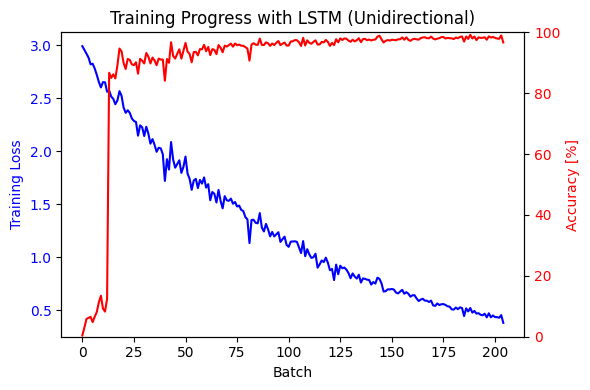

Evaluating: 100%|██████████| 5/5 [00:00<00:00, 26.50batch/s]


Test accuracy with LSTM (Unidirectional): 97.45%

--- Language: es_gsd ---
Loading dataset [universal_dependencies] with config = 'es_gsd'
DatasetDict({
    train: Dataset({
        features: ['idx', 'text', 'tokens', 'lemmas', 'upos', 'xpos', 'feats', 'head', 'deprel', 'deps', 'misc'],
        num_rows: 14187
    })
    validation: Dataset({
        features: ['idx', 'text', 'tokens', 'lemmas', 'upos', 'xpos', 'feats', 'head', 'deprel', 'deps', 'misc'],
        num_rows: 1400
    })
    test: Dataset({
        features: ['idx', 'text', 'tokens', 'lemmas', 'upos', 'xpos', 'feats', 'head', 'deprel', 'deps', 'misc'],
        num_rows: 426
    })
})
['Además', 'se', 'le', 'pediría', 'a', 'las', 'empresas', 'interesadas', 'en', 'prestar', 'el', 'servicio', 'que', 'se', 'hagan', 'cargo', 'de', 'la', 'señalización', 'y', 'la', 'cartelería', 'que', 'contiene', 'información', 'para', 'los', 'usuarios', '.']
[14, 11, 11, 16, 2, 8, 0, 6, 2, 16, 8, 0, 5, 11, 16, 0, 2, 8, 0, 9, 8, 0, 5, 16, 0, 2, 

Epoch 1/5 (LSTM, Unidirectional): 100%|██████████| 50/50 [00:24<00:00,  2.02batch/s, accuracy=91.54%, loss=1.5522]


Epoch 1/5 - Loss: 2.1070, Accuracy: 82.46%


Epoch 2/5 (LSTM, Unidirectional): 100%|██████████| 50/50 [00:23<00:00,  2.11batch/s, accuracy=94.59%, loss=0.9109]


Epoch 2/5 - Loss: 1.2906, Accuracy: 95.30%


Epoch 3/5 (LSTM, Unidirectional): 100%|██████████| 50/50 [00:24<00:00,  2.04batch/s, accuracy=97.48%, loss=0.6049]


Epoch 3/5 - Loss: 0.7910, Accuracy: 97.33%


Epoch 4/5 (LSTM, Unidirectional): 100%|██████████| 50/50 [00:25<00:00,  1.94batch/s, accuracy=98.75%, loss=0.4079]


Epoch 4/5 - Loss: 0.4838, Accuracy: 98.19%


Epoch 5/5 (LSTM, Unidirectional): 100%|██████████| 50/50 [00:26<00:00,  1.92batch/s, accuracy=98.98%, loss=0.2794]


Epoch 5/5 - Loss: 0.3151, Accuracy: 98.72%


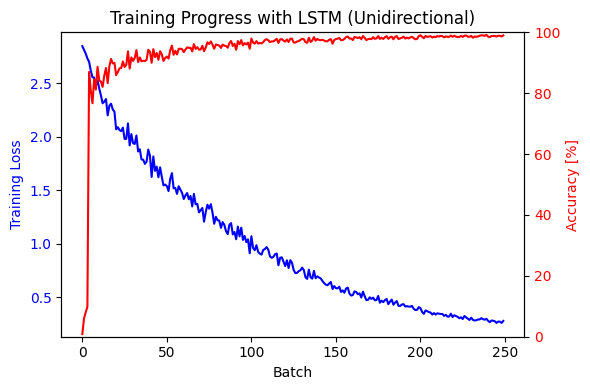

Evaluating: 100%|██████████| 6/6 [00:00<00:00, 15.58batch/s]


Test accuracy with LSTM (Unidirectional): 97.11%

--- Language: zh_gsdsimp ---
Loading dataset [universal_dependencies] with config = 'zh_gsdsimp'
DatasetDict({
    train: Dataset({
        features: ['idx', 'text', 'tokens', 'lemmas', 'upos', 'xpos', 'feats', 'head', 'deprel', 'deps', 'misc'],
        num_rows: 3997
    })
    validation: Dataset({
        features: ['idx', 'text', 'tokens', 'lemmas', 'upos', 'xpos', 'feats', 'head', 'deprel', 'deps', 'misc'],
        num_rows: 500
    })
    test: Dataset({
        features: ['idx', 'text', 'tokens', 'lemmas', 'upos', 'xpos', 'feats', 'head', 'deprel', 'deps', 'misc'],
        num_rows: 500
    })
})
['看似', '简单', '，', '只', '是', '二', '选', '一', '做', '决择', '，', '但', '其实', '他们', '代表', '的', '是', '你', '周遭', '的', '亲朋', '好友', '，', '试', '着', '给', '你', '不同', '的', '意见', '，', '但', '追根究底', '，', '最后', '决定', '的', '还是', '自己', '。']
[17, 6, 1, 14, 16, 3, 16, 3, 16, 0, 1, 14, 14, 11, 16, 7, 17, 11, 0, 7, 0, 0, 1, 16, 7, 16, 11, 6, 7, 0, 1, 14, 16, 1, 0

Epoch 1/5 (LSTM, Unidirectional): 100%|██████████| 15/15 [00:05<00:00,  2.78batch/s, accuracy=65.68%, loss=2.0318]


Epoch 1/5 - Loss: 2.4832, Accuracy: 33.31%


Epoch 2/5 (LSTM, Unidirectional): 100%|██████████| 15/15 [00:05<00:00,  2.76batch/s, accuracy=75.42%, loss=1.7919]


Epoch 2/5 - Loss: 2.1161, Accuracy: 84.57%


Epoch 3/5 (LSTM, Unidirectional): 100%|██████████| 15/15 [00:05<00:00,  2.88batch/s, accuracy=83.28%, loss=1.5189]


Epoch 3/5 - Loss: 1.8406, Accuracy: 88.38%


Epoch 4/5 (LSTM, Unidirectional): 100%|██████████| 15/15 [00:05<00:00,  2.71batch/s, accuracy=84.22%, loss=1.2985]


Epoch 4/5 - Loss: 1.5775, Accuracy: 91.18%


Epoch 5/5 (LSTM, Unidirectional): 100%|██████████| 15/15 [00:05<00:00,  2.91batch/s, accuracy=90.38%, loss=1.0756]


Epoch 5/5 - Loss: 1.3454, Accuracy: 93.39%


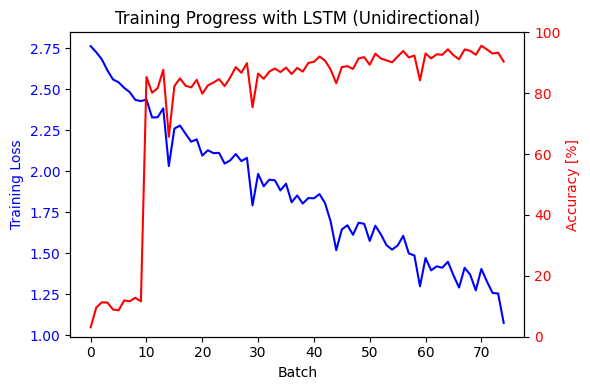

Evaluating: 100%|██████████| 2/2 [00:00<00:00, 18.94batch/s]


Test accuracy with LSTM (Unidirectional): 91.78%

--- Language: de_gsd ---
Loading dataset [universal_dependencies] with config = 'de_gsd'
DatasetDict({
    train: Dataset({
        features: ['idx', 'text', 'tokens', 'lemmas', 'upos', 'xpos', 'feats', 'head', 'deprel', 'deps', 'misc'],
        num_rows: 13814
    })
    validation: Dataset({
        features: ['idx', 'text', 'tokens', 'lemmas', 'upos', 'xpos', 'feats', 'head', 'deprel', 'deps', 'misc'],
        num_rows: 799
    })
    test: Dataset({
        features: ['idx', 'text', 'tokens', 'lemmas', 'upos', 'xpos', 'feats', 'head', 'deprel', 'deps', 'misc'],
        num_rows: 977
    })
})
['Sehr', 'gute', 'Beratung', ',', 'schnelle', 'Behebung', 'der', 'Probleme', ',', 'so', 'stelle', 'ich', 'mir', 'Kundenservice', 'vor', '.']
[14, 6, 0, 1, 6, 0, 8, 0, 1, 14, 16, 11, 11, 0, 2, 1]
Loaded 13800 sentences
(['Sehr', 'gute', 'Beratung', ',', 'schnelle', 'Behebung', 'der', 'Probleme', ',', 'so', 'stelle', 'ich', 'mir', 'Kundenservice'

Epoch 1/5 (LSTM, Unidirectional): 100%|██████████| 49/49 [00:14<00:00,  3.44batch/s, accuracy=89.67%, loss=1.7005]


Epoch 1/5 - Loss: 2.2233, Accuracy: 70.03%


Epoch 2/5 (LSTM, Unidirectional): 100%|██████████| 49/49 [00:14<00:00,  3.34batch/s, accuracy=93.06%, loss=1.0349]


Epoch 2/5 - Loss: 1.3905, Accuracy: 93.34%


Epoch 3/5 (LSTM, Unidirectional): 100%|██████████| 49/49 [00:14<00:00,  3.28batch/s, accuracy=96.39%, loss=0.6903]


Epoch 3/5 - Loss: 0.8634, Accuracy: 96.11%


Epoch 4/5 (LSTM, Unidirectional): 100%|██████████| 49/49 [00:14<00:00,  3.48batch/s, accuracy=97.83%, loss=0.4288]


Epoch 4/5 - Loss: 0.5309, Accuracy: 97.57%


Epoch 5/5 (LSTM, Unidirectional): 100%|██████████| 49/49 [00:13<00:00,  3.64batch/s, accuracy=98.54%, loss=0.2960]


Epoch 5/5 - Loss: 0.3404, Accuracy: 98.42%


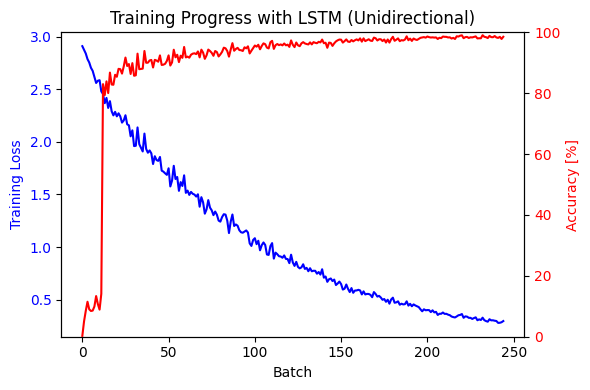

Evaluating: 100%|██████████| 6/6 [00:00<00:00, 18.01batch/s]


Test accuracy with LSTM (Unidirectional): 96.68%

=== Model Complexity: HighComplex (emb=64, hid=128) ===
--- Language: en_ewt ---
Loading dataset [universal_dependencies] with config = 'en_ewt'
DatasetDict({
    train: Dataset({
        features: ['idx', 'text', 'tokens', 'lemmas', 'upos', 'xpos', 'feats', 'head', 'deprel', 'deps', 'misc'],
        num_rows: 12543
    })
    validation: Dataset({
        features: ['idx', 'text', 'tokens', 'lemmas', 'upos', 'xpos', 'feats', 'head', 'deprel', 'deps', 'misc'],
        num_rows: 2002
    })
    test: Dataset({
        features: ['idx', 'text', 'tokens', 'lemmas', 'upos', 'xpos', 'feats', 'head', 'deprel', 'deps', 'misc'],
        num_rows: 2077
    })
})
['Al', '-', 'Zaman', ':', 'American', 'forces', 'killed', 'Shaikh', 'Abdullah', 'al', '-', 'Ani', ',', 'the', 'preacher', 'at', 'the', 'mosque', 'in', 'the', 'town', 'of', 'Qaim', ',', 'near', 'the', 'Syrian', 'border', '.']
[10, 1, 10, 1, 6, 0, 16, 10, 10, 10, 1, 10, 1, 8, 0, 2, 8, 0, 2

Epoch 1/5 (LSTM, Unidirectional): 100%|██████████| 41/41 [00:27<00:00,  1.50batch/s, accuracy=92.62%, loss=1.7948]


Epoch 1/5 - Loss: 2.2892, Accuracy: 74.70%


Epoch 2/5 (LSTM, Unidirectional): 100%|██████████| 41/41 [00:26<00:00,  1.55batch/s, accuracy=94.49%, loss=1.0722]


Epoch 2/5 - Loss: 1.5629, Accuracy: 96.21%


Epoch 3/5 (LSTM, Unidirectional): 100%|██████████| 41/41 [00:27<00:00,  1.48batch/s, accuracy=97.76%, loss=0.7741]


Epoch 3/5 - Loss: 1.0668, Accuracy: 97.70%


Epoch 4/5 (LSTM, Unidirectional): 100%|██████████| 41/41 [00:28<00:00,  1.42batch/s, accuracy=98.59%, loss=0.5350]


Epoch 4/5 - Loss: 0.7056, Accuracy: 98.50%


Epoch 5/5 (LSTM, Unidirectional): 100%|██████████| 41/41 [00:29<00:00,  1.39batch/s, accuracy=98.16%, loss=0.3211]


Epoch 5/5 - Loss: 0.4732, Accuracy: 98.91%


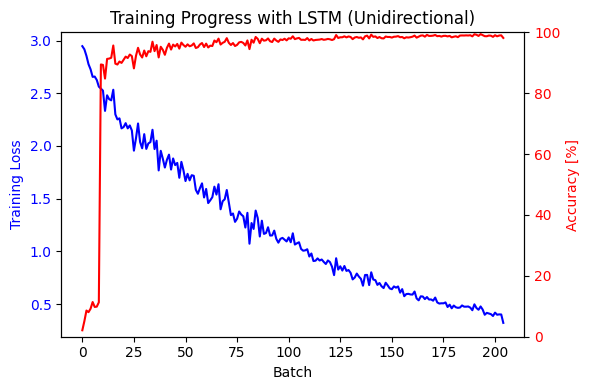

Evaluating: 100%|██████████| 5/5 [00:00<00:00, 11.04batch/s]


Test accuracy with LSTM (Unidirectional): 97.64%

--- Language: es_gsd ---
Loading dataset [universal_dependencies] with config = 'es_gsd'
DatasetDict({
    train: Dataset({
        features: ['idx', 'text', 'tokens', 'lemmas', 'upos', 'xpos', 'feats', 'head', 'deprel', 'deps', 'misc'],
        num_rows: 14187
    })
    validation: Dataset({
        features: ['idx', 'text', 'tokens', 'lemmas', 'upos', 'xpos', 'feats', 'head', 'deprel', 'deps', 'misc'],
        num_rows: 1400
    })
    test: Dataset({
        features: ['idx', 'text', 'tokens', 'lemmas', 'upos', 'xpos', 'feats', 'head', 'deprel', 'deps', 'misc'],
        num_rows: 426
    })
})
['Además', 'se', 'le', 'pediría', 'a', 'las', 'empresas', 'interesadas', 'en', 'prestar', 'el', 'servicio', 'que', 'se', 'hagan', 'cargo', 'de', 'la', 'señalización', 'y', 'la', 'cartelería', 'que', 'contiene', 'información', 'para', 'los', 'usuarios', '.']
[14, 11, 11, 16, 2, 8, 0, 6, 2, 16, 8, 0, 5, 11, 16, 0, 2, 8, 0, 9, 8, 0, 5, 16, 0, 2, 

Epoch 1/5 (LSTM, Unidirectional): 100%|██████████| 50/50 [00:59<00:00,  1.19s/batch, accuracy=95.22%, loss=1.6142]


Epoch 1/5 - Loss: 2.0407, Accuracy: 88.72%


Epoch 2/5 (LSTM, Unidirectional): 100%|██████████| 50/50 [00:59<00:00,  1.19s/batch, accuracy=96.75%, loss=0.9733]


Epoch 2/5 - Loss: 1.2583, Accuracy: 96.52%


Epoch 3/5 (LSTM, Unidirectional): 100%|██████████| 50/50 [01:01<00:00,  1.23s/batch, accuracy=98.00%, loss=0.5779]


Epoch 3/5 - Loss: 0.7624, Accuracy: 98.02%


Epoch 4/5 (LSTM, Unidirectional): 100%|██████████| 50/50 [00:59<00:00,  1.20s/batch, accuracy=98.59%, loss=0.3571]


Epoch 4/5 - Loss: 0.4634, Accuracy: 98.70%


Epoch 5/5 (LSTM, Unidirectional): 100%|██████████| 50/50 [00:58<00:00,  1.18s/batch, accuracy=99.48%, loss=0.2720]


Epoch 5/5 - Loss: 0.3007, Accuracy: 99.11%


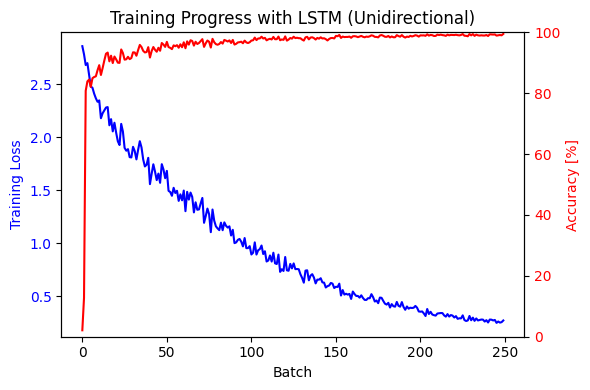

Evaluating: 100%|██████████| 6/6 [00:00<00:00,  7.40batch/s]


Test accuracy with LSTM (Unidirectional): 98.09%

--- Language: zh_gsdsimp ---
Loading dataset [universal_dependencies] with config = 'zh_gsdsimp'
DatasetDict({
    train: Dataset({
        features: ['idx', 'text', 'tokens', 'lemmas', 'upos', 'xpos', 'feats', 'head', 'deprel', 'deps', 'misc'],
        num_rows: 3997
    })
    validation: Dataset({
        features: ['idx', 'text', 'tokens', 'lemmas', 'upos', 'xpos', 'feats', 'head', 'deprel', 'deps', 'misc'],
        num_rows: 500
    })
    test: Dataset({
        features: ['idx', 'text', 'tokens', 'lemmas', 'upos', 'xpos', 'feats', 'head', 'deprel', 'deps', 'misc'],
        num_rows: 500
    })
})
['看似', '简单', '，', '只', '是', '二', '选', '一', '做', '决择', '，', '但', '其实', '他们', '代表', '的', '是', '你', '周遭', '的', '亲朋', '好友', '，', '试', '着', '给', '你', '不同', '的', '意见', '，', '但', '追根究底', '，', '最后', '决定', '的', '还是', '自己', '。']
[17, 6, 1, 14, 16, 3, 16, 3, 16, 0, 1, 14, 14, 11, 16, 7, 17, 11, 0, 7, 0, 0, 1, 16, 7, 16, 11, 6, 7, 0, 1, 14, 16, 1, 0

Epoch 1/5 (LSTM, Unidirectional): 100%|██████████| 15/15 [00:12<00:00,  1.22batch/s, accuracy=74.84%, loss=1.9266]


Epoch 1/5 - Loss: 2.3815, Accuracy: 57.35%


Epoch 2/5 (LSTM, Unidirectional): 100%|██████████| 15/15 [00:12<00:00,  1.23batch/s, accuracy=86.15%, loss=1.6888]


Epoch 2/5 - Loss: 1.9951, Accuracy: 87.06%


Epoch 3/5 (LSTM, Unidirectional): 100%|██████████| 15/15 [00:12<00:00,  1.19batch/s, accuracy=88.54%, loss=1.3417]


Epoch 3/5 - Loss: 1.6899, Accuracy: 91.37%


Epoch 4/5 (LSTM, Unidirectional): 100%|██████████| 15/15 [00:12<00:00,  1.18batch/s, accuracy=92.43%, loss=1.2363]


Epoch 4/5 - Loss: 1.4440, Accuracy: 94.11%


Epoch 5/5 (LSTM, Unidirectional): 100%|██████████| 15/15 [00:12<00:00,  1.20batch/s, accuracy=92.63%, loss=0.9556]


Epoch 5/5 - Loss: 1.2098, Accuracy: 95.62%


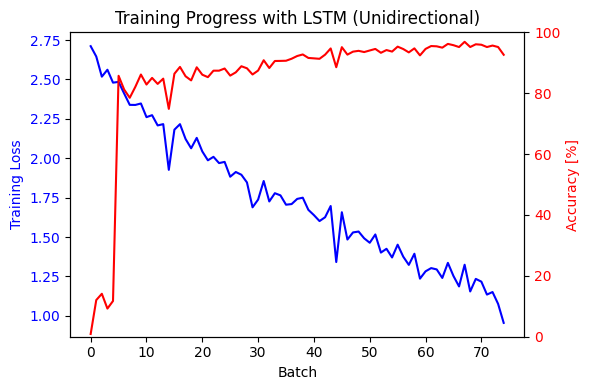

Evaluating: 100%|██████████| 2/2 [00:00<00:00,  9.92batch/s]


Test accuracy with LSTM (Unidirectional): 93.90%

--- Language: de_gsd ---
Loading dataset [universal_dependencies] with config = 'de_gsd'
DatasetDict({
    train: Dataset({
        features: ['idx', 'text', 'tokens', 'lemmas', 'upos', 'xpos', 'feats', 'head', 'deprel', 'deps', 'misc'],
        num_rows: 13814
    })
    validation: Dataset({
        features: ['idx', 'text', 'tokens', 'lemmas', 'upos', 'xpos', 'feats', 'head', 'deprel', 'deps', 'misc'],
        num_rows: 799
    })
    test: Dataset({
        features: ['idx', 'text', 'tokens', 'lemmas', 'upos', 'xpos', 'feats', 'head', 'deprel', 'deps', 'misc'],
        num_rows: 977
    })
})
['Sehr', 'gute', 'Beratung', ',', 'schnelle', 'Behebung', 'der', 'Probleme', ',', 'so', 'stelle', 'ich', 'mir', 'Kundenservice', 'vor', '.']
[14, 6, 0, 1, 6, 0, 8, 0, 1, 14, 16, 11, 11, 0, 2, 1]
Loaded 13800 sentences
(['Sehr', 'gute', 'Beratung', ',', 'schnelle', 'Behebung', 'der', 'Probleme', ',', 'so', 'stelle', 'ich', 'mir', 'Kundenservice'

Epoch 1/5 (LSTM, Unidirectional): 100%|██████████| 49/49 [00:33<00:00,  1.48batch/s, accuracy=93.29%, loss=1.5900]


Epoch 1/5 - Loss: 2.0539, Accuracy: 83.96%


Epoch 2/5 (LSTM, Unidirectional): 100%|██████████| 49/49 [00:33<00:00,  1.47batch/s, accuracy=94.11%, loss=0.9412]


Epoch 2/5 - Loss: 1.2711, Accuracy: 95.11%


Epoch 3/5 (LSTM, Unidirectional): 100%|██████████| 49/49 [00:32<00:00,  1.49batch/s, accuracy=97.54%, loss=0.6313]


Epoch 3/5 - Loss: 0.7791, Accuracy: 97.30%


Epoch 4/5 (LSTM, Unidirectional): 100%|██████████| 49/49 [00:30<00:00,  1.59batch/s, accuracy=98.20%, loss=0.3649]


Epoch 4/5 - Loss: 0.4759, Accuracy: 98.55%


Epoch 5/5 (LSTM, Unidirectional): 100%|██████████| 49/49 [00:31<00:00,  1.57batch/s, accuracy=98.96%, loss=0.2665]


Epoch 5/5 - Loss: 0.3055, Accuracy: 99.17%


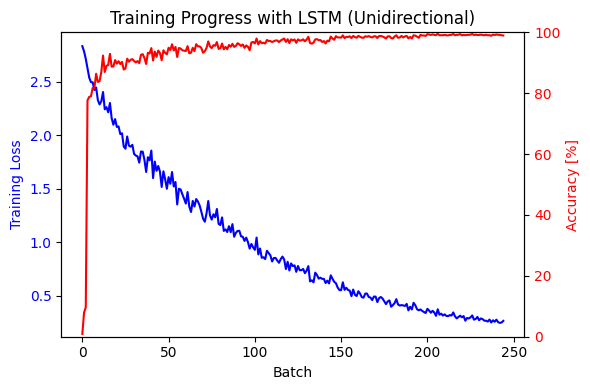

Evaluating: 100%|██████████| 6/6 [00:00<00:00,  9.82batch/s]

Test accuracy with LSTM (Unidirectional): 95.98%



In [52]:
model_complexities = [
    {"name": "LowComplex", "embedding_dim": 32, "hidden_dim": 64},
    {"name": "HighComplex", "embedding_dim": 64, "hidden_dim": 128},
]

languages = ["en_ewt", "es_gsd", "zh_gsdsimp", "de_gsd"]

for mc in model_complexities:
    print(f"=== Model Complexity: {mc['name']} (emb={mc['embedding_dim']}, hid={mc['hidden_dim']}) ===")
    for lang in ["en_ewt", "es_gsd", "zh_gsdsimp", "de_gsd"]:
        print(f"--- Language: {lang} ---")

        tagger = POSTagger(
            word_embedding_dim=mc["embedding_dim"],
            hidden_dim=mc["hidden_dim"],
            batch_size=256,
            learning_rate=0.01,
            epochs=5,
            rnn_type='lstm'
        )
        tagger.run(language=lang)
        print()


Under the low-complexity model, the accuracy for the four languages mostly falls between 90% and 97%. With the high-complexity model, accuracy generally improves further, with some languages reaching around 98% to 99%.  

Overall, increasing the model dimensions allows for better capturing of morphological, word order, and contextual features across different languages, leading to faster convergence or higher final accuracy. However, for some languages, the improvement is relatively limited, suggesting that under this task and dataset size, a smaller network is already capable of learning the key patterns. On the other hand, while larger models tend to reach high accuracy more quickly in the early training stages, it is also important to consider the potential risk of overfitting.